# Deep Convolutional WGANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

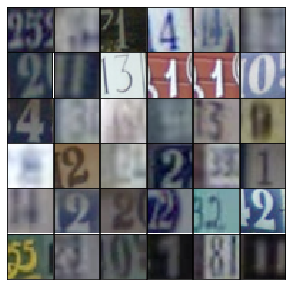

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)): # tanh
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range (-1, 1)
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(self.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3.

In [9]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x1 = tf.layers.dense(z, 4*4*512)
        # Reshape it to start the convolutional stack
        x1 = tf.reshape(x1, (-1, 4, 4, 512))
        x1 = tf.layers.batch_normalization(x1, training=training)
        x1 = tf.maximum(alpha * x1, x1)
        # 4x4x512 now
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(alpha * x2, x2)
        # 8x8x256 now
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.maximum(alpha * x3, x3)
        # 16x16x128 now
        
        # Output layer
        logits = tf.layers.conv2d_transpose(x3, output_dim, 5, strides=2, padding='same')
        # 32x32x3 now
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've build before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU. 

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

In [10]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        relu1 = tf.maximum(alpha * x1, x1)
        # 16x16x64
        
        x2 = tf.layers.conv2d(relu1, 128, 5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 = tf.maximum(alpha * bn2, bn2)
        # 8x8x128
        
        x3 = tf.layers.conv2d(relu2, 256, 5, strides=2, padding='same')
        bn3 = tf.layers.batch_normalization(x3, training=True)
        relu3 = tf.maximum(alpha * bn3, bn3)
        # 4x4x256

        # Flatten it
        flat = tf.reshape(relu3, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1)
        
        return logits

## Model Loss

Calculating the loss like before, nothing new here.

In [12]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    input_gen = generator(input_z, output_dim, alpha=alpha)
    Q = discriminator(input_real, alpha=alpha)
    q = discriminator(input_gen, alpha=alpha, reuse=True)
    d_loss = tf.reduce_mean(q-Q) 
    g_loss = tf.reduce_mean(Q-q)
    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [13]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [14]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z, real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [15]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [16]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))
                
                if len(x) != batch_size:
                    print(batch_z.shape, x.shape)
                    
                else:
                    # Run optimizers
                    dloss, _ = sess.run([net.d_loss, net.d_opt], feed_dict={net.input_real: x, net.input_z: batch_z})
                    gloss, _ = sess.run([net.g_loss, net.g_opt], feed_dict={net.input_real: x, net.input_z: batch_z})

                    steps += 1
                    if steps % print_every == 0:
                        print("Epoch {}/{}...".format(e+1, epochs),
                              "Dloss: {:.4f}".format(dloss),
                              "Gloss: {:.4f}".format(gloss))
                        # Save losses to view after training
                        losses.append((dloss, gloss))

                    if steps % show_every == 0:
                        gen_samples = sess.run(
                                       generator(net.input_z, 3, reuse=True, training=False),
                                       feed_dict={net.input_z: sample_z})
                        samples.append(gen_samples)
                        _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                        plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

        with open('samples.pkl', 'wb') as f:
            pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

In [17]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 100
alpha = 0.2
beta1 = 0.5

tf.reset_default_graph()

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

dataset = Dataset(trainset, testset)

Epoch 1/100... Dloss: -4.7696 Gloss: 14.2725
Epoch 1/100... Dloss: -19.4132 Gloss: 32.0700
Epoch 1/100... Dloss: -47.0008 Gloss: 58.2525
Epoch 1/100... Dloss: -58.1996 Gloss: 69.0163
Epoch 1/100... Dloss: -72.9585 Gloss: 83.0568
Epoch 1/100... Dloss: -88.3440 Gloss: 98.9344
Epoch 1/100... Dloss: -85.1984 Gloss: 103.7909
Epoch 1/100... Dloss: -32.1740 Gloss: 46.2997
Epoch 1/100... Dloss: -47.6827 Gloss: 61.8798
Epoch 1/100... Dloss: -86.3465 Gloss: 91.4786


/home/arasdar/anaconda3/lib/python3.6/site-packages/matplotlib/axes/_base.py:1324: MatplotlibDeprecationWarning: 
box-forced
  "2.2", "box-forced", obj_type="keyword argument")


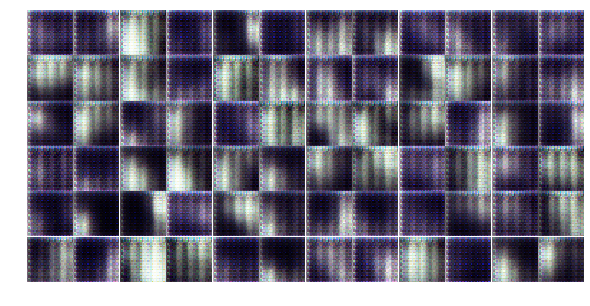

Epoch 1/100... Dloss: -83.6677 Gloss: 102.0705
Epoch 1/100... Dloss: -121.8793 Gloss: 133.2711
Epoch 1/100... Dloss: -80.3891 Gloss: 99.0885
Epoch 1/100... Dloss: -138.7985 Gloss: 144.9187
Epoch 1/100... Dloss: -152.9599 Gloss: 157.8381
Epoch 1/100... Dloss: -175.7045 Gloss: 179.5170
Epoch 1/100... Dloss: -126.3891 Gloss: 174.0667
Epoch 1/100... Dloss: -75.8965 Gloss: 122.3247
Epoch 1/100... Dloss: -82.0353 Gloss: 119.4837
Epoch 1/100... Dloss: -213.7272 Gloss: 218.6682


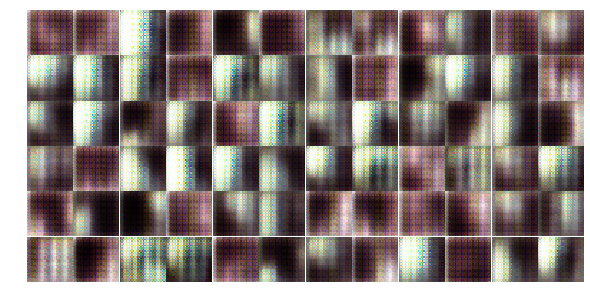

Epoch 1/100... Dloss: -176.5975 Gloss: 182.0735
Epoch 1/100... Dloss: -91.5210 Gloss: 123.8579
Epoch 1/100... Dloss: -38.2792 Gloss: 74.0344
Epoch 1/100... Dloss: -128.1848 Gloss: 173.7100
Epoch 1/100... Dloss: -101.5755 Gloss: 142.2780
Epoch 1/100... Dloss: -58.0533 Gloss: 107.1574
Epoch 1/100... Dloss: -88.6592 Gloss: 123.8813
Epoch 1/100... Dloss: -167.0652 Gloss: 195.1063
Epoch 1/100... Dloss: -68.1045 Gloss: 94.7935
Epoch 1/100... Dloss: -91.8058 Gloss: 143.0513


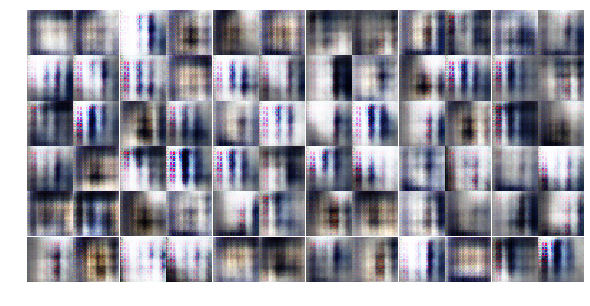

Epoch 1/100... Dloss: -130.6278 Gloss: 166.0413
Epoch 1/100... Dloss: -96.1831 Gloss: 160.1132
Epoch 1/100... Dloss: -132.0791 Gloss: 210.4801
Epoch 1/100... Dloss: -143.7842 Gloss: 217.8116
Epoch 1/100... Dloss: -121.3396 Gloss: 156.4718
Epoch 1/100... Dloss: -64.3723 Gloss: 120.9381
Epoch 1/100... Dloss: -131.9583 Gloss: 154.3708
Epoch 1/100... Dloss: -59.7328 Gloss: 162.5388
Epoch 1/100... Dloss: -82.8128 Gloss: 99.4537
Epoch 1/100... Dloss: -125.9655 Gloss: 168.2581


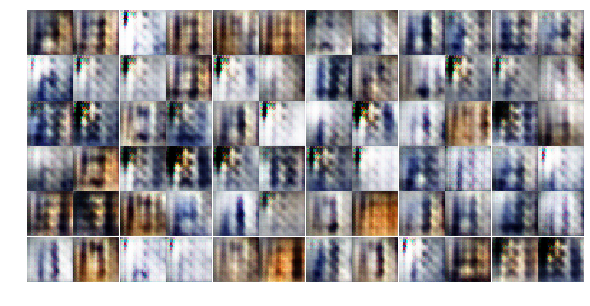

Epoch 1/100... Dloss: -112.0945 Gloss: 158.4701
Epoch 1/100... Dloss: -72.9841 Gloss: 128.0221
Epoch 1/100... Dloss: -108.0241 Gloss: 137.1533
Epoch 1/100... Dloss: -130.1880 Gloss: 164.3854
Epoch 1/100... Dloss: -118.4815 Gloss: 159.4013
Epoch 1/100... Dloss: -36.5600 Gloss: 100.8509
Epoch 1/100... Dloss: -67.9070 Gloss: 103.3683
Epoch 1/100... Dloss: -115.1112 Gloss: 163.8835
Epoch 1/100... Dloss: -117.0082 Gloss: 184.9852
Epoch 1/100... Dloss: 7.1779 Gloss: 92.0268


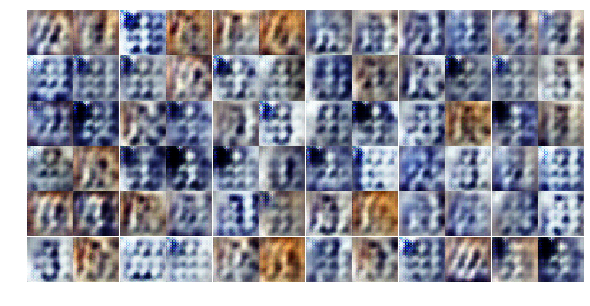

Epoch 1/100... Dloss: -91.0971 Gloss: 147.8742
Epoch 1/100... Dloss: -61.8975 Gloss: 122.0843
Epoch 1/100... Dloss: -123.9176 Gloss: 170.0114
Epoch 1/100... Dloss: -137.3983 Gloss: 186.7925
Epoch 1/100... Dloss: -147.8125 Gloss: 200.9737
Epoch 1/100... Dloss: -76.3228 Gloss: 103.7901
Epoch 1/100... Dloss: -114.0618 Gloss: 191.4940
(128, 100) (41, 32, 32, 3)
Epoch 2/100... Dloss: -54.8067 Gloss: 113.8438
Epoch 2/100... Dloss: -50.3870 Gloss: 118.5269
Epoch 2/100... Dloss: -212.3518 Gloss: 260.9423


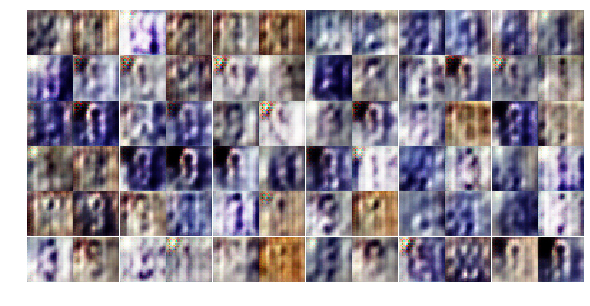

Epoch 2/100... Dloss: -134.9727 Gloss: 229.7010
Epoch 2/100... Dloss: -155.0110 Gloss: 228.2606
Epoch 2/100... Dloss: -101.5925 Gloss: 186.2993
Epoch 2/100... Dloss: -109.3885 Gloss: 169.0169
Epoch 2/100... Dloss: -121.8369 Gloss: 208.5720
Epoch 2/100... Dloss: -213.2264 Gloss: 262.1420
Epoch 2/100... Dloss: -201.8401 Gloss: 268.8658
Epoch 2/100... Dloss: -47.2578 Gloss: 99.3951
Epoch 2/100... Dloss: -80.6691 Gloss: 144.7704
Epoch 2/100... Dloss: -134.8589 Gloss: 181.2357


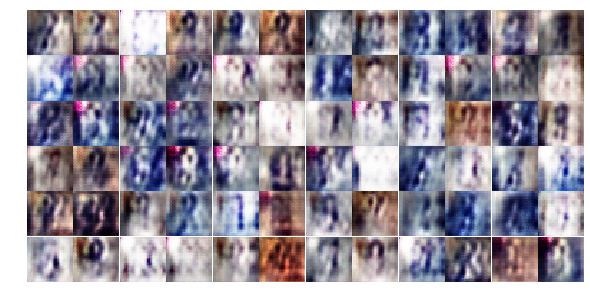

Epoch 2/100... Dloss: -98.5579 Gloss: 198.9240
Epoch 2/100... Dloss: -6.7242 Gloss: 81.7004
Epoch 2/100... Dloss: -64.3246 Gloss: 153.5281
Epoch 2/100... Dloss: 53.3111 Gloss: 9.2224
Epoch 2/100... Dloss: 9.0521 Gloss: 7.6008
Epoch 2/100... Dloss: -142.4072 Gloss: 184.4154
Epoch 2/100... Dloss: -326.4615 Gloss: 356.2451
Epoch 2/100... Dloss: -107.9241 Gloss: 170.9906
Epoch 2/100... Dloss: -111.8075 Gloss: 211.9331
Epoch 2/100... Dloss: -98.0310 Gloss: 137.8194


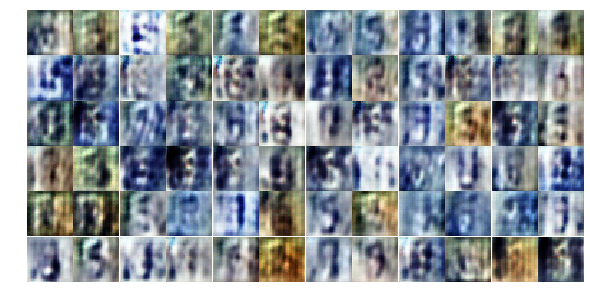

Epoch 2/100... Dloss: -190.1651 Gloss: 249.4647
Epoch 2/100... Dloss: -234.1552 Gloss: 284.1839
Epoch 2/100... Dloss: -27.8126 Gloss: 85.7999
Epoch 2/100... Dloss: -167.1191 Gloss: 153.0535
Epoch 2/100... Dloss: -70.3922 Gloss: 141.4555
Epoch 2/100... Dloss: -75.6060 Gloss: 154.5508
Epoch 2/100... Dloss: -63.7214 Gloss: 88.9484
Epoch 2/100... Dloss: -35.1920 Gloss: 119.5422
Epoch 2/100... Dloss: -108.1008 Gloss: 198.3049
Epoch 2/100... Dloss: -155.2606 Gloss: 226.7802


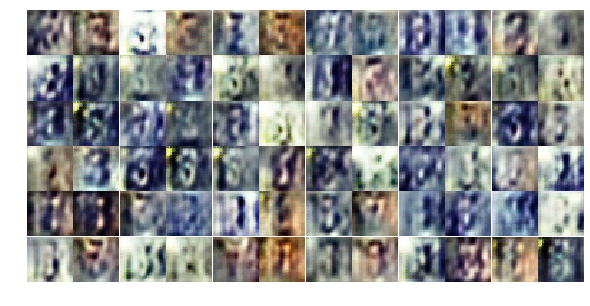

Epoch 2/100... Dloss: -183.7382 Gloss: 286.6857
Epoch 2/100... Dloss: 45.9506 Gloss: -11.6837
Epoch 2/100... Dloss: 1.0827 Gloss: 27.6183
Epoch 2/100... Dloss: -81.6451 Gloss: 101.7389
Epoch 2/100... Dloss: 30.8012 Gloss: -15.6005
Epoch 2/100... Dloss: -31.4728 Gloss: 47.3400
Epoch 2/100... Dloss: -33.0756 Gloss: 60.9197
Epoch 2/100... Dloss: -159.1275 Gloss: 213.7264
Epoch 2/100... Dloss: -113.2283 Gloss: 315.9873
Epoch 2/100... Dloss: -166.6759 Gloss: 305.0201


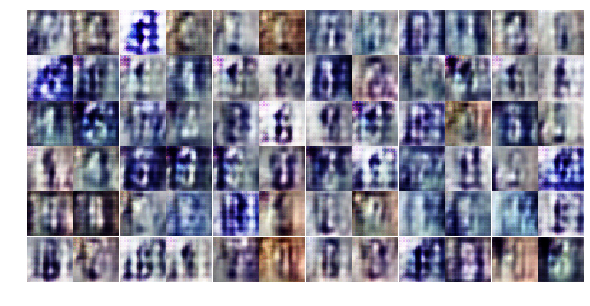

Epoch 2/100... Dloss: -241.2365 Gloss: 209.0171
Epoch 2/100... Dloss: -80.1680 Gloss: 180.6618
Epoch 2/100... Dloss: -189.8735 Gloss: 306.3259
Epoch 2/100... Dloss: -130.5026 Gloss: 224.1221
Epoch 2/100... Dloss: 10.1752 Gloss: 57.7843
Epoch 2/100... Dloss: 10.3040 Gloss: 61.1431
Epoch 2/100... Dloss: -211.7815 Gloss: 157.4760
Epoch 2/100... Dloss: -264.3463 Gloss: 329.4856
Epoch 2/100... Dloss: -183.9574 Gloss: 277.3220
Epoch 2/100... Dloss: -72.6175 Gloss: 147.6755


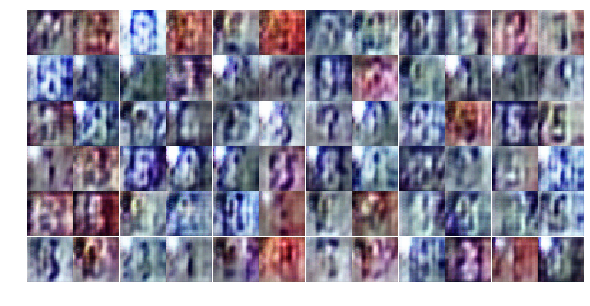

Epoch 2/100... Dloss: -325.0284 Gloss: 431.0027
Epoch 2/100... Dloss: -142.7198 Gloss: 447.9644
Epoch 2/100... Dloss: -14.8588 Gloss: 206.7650
Epoch 2/100... Dloss: -68.8230 Gloss: 213.2812
(128, 100) (41, 32, 32, 3)
Epoch 3/100... Dloss: -458.4113 Gloss: 427.6185
Epoch 3/100... Dloss: -166.0194 Gloss: 459.3380
Epoch 3/100... Dloss: -45.9909 Gloss: 150.0128
Epoch 3/100... Dloss: -491.2657 Gloss: 553.6851
Epoch 3/100... Dloss: -125.7367 Gloss: 291.2383
Epoch 3/100... Dloss: -209.7166 Gloss: 429.7333


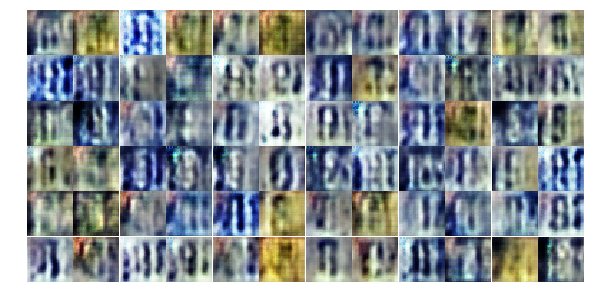

Epoch 3/100... Dloss: -190.0996 Gloss: 253.6555
Epoch 3/100... Dloss: -221.0443 Gloss: 416.7863
Epoch 3/100... Dloss: -179.2906 Gloss: 258.9828
Epoch 3/100... Dloss: -372.3807 Gloss: 523.6556
Epoch 3/100... Dloss: -9.5357 Gloss: 46.6373
Epoch 3/100... Dloss: -412.1682 Gloss: 567.8271
Epoch 3/100... Dloss: -135.8654 Gloss: 165.5486
Epoch 3/100... Dloss: -768.8961 Gloss: 805.0554
Epoch 3/100... Dloss: 20.7671 Gloss: 31.9402
Epoch 3/100... Dloss: -21.0798 Gloss: 35.8430


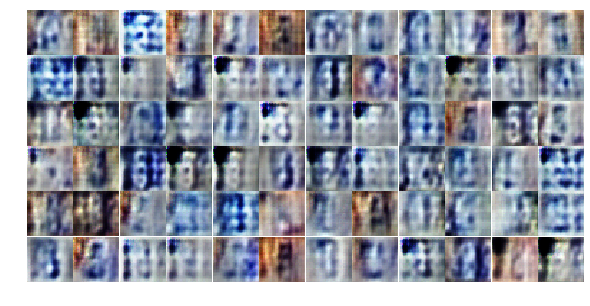

Epoch 3/100... Dloss: -6.0425 Gloss: 17.0476
Epoch 3/100... Dloss: 12.3279 Gloss: -7.3961
Epoch 3/100... Dloss: -9.4545 Gloss: 14.6997
Epoch 3/100... Dloss: -15.6165 Gloss: 21.2349
Epoch 3/100... Dloss: -13.9238 Gloss: 20.2500
Epoch 3/100... Dloss: -208.6960 Gloss: 301.3214
Epoch 3/100... Dloss: -298.6693 Gloss: 410.1673
Epoch 3/100... Dloss: -192.3873 Gloss: 315.5458
Epoch 3/100... Dloss: -365.8353 Gloss: 589.6767
Epoch 3/100... Dloss: -217.7443 Gloss: 389.6076


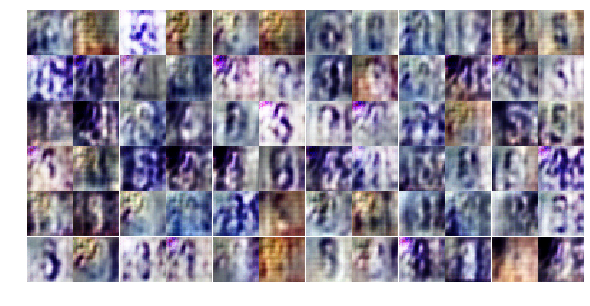

Epoch 3/100... Dloss: -289.2460 Gloss: 104.7448
Epoch 3/100... Dloss: -47.3938 Gloss: 194.3913
Epoch 3/100... Dloss: -105.5201 Gloss: 164.7676
Epoch 3/100... Dloss: -137.6267 Gloss: 230.7270
Epoch 3/100... Dloss: 15.2883 Gloss: 67.5578
Epoch 3/100... Dloss: -144.9185 Gloss: 237.9536
Epoch 3/100... Dloss: -338.4396 Gloss: 554.9083
Epoch 3/100... Dloss: -357.6204 Gloss: 478.2960
Epoch 3/100... Dloss: -790.3425 Gloss: 897.0046
Epoch 3/100... Dloss: -22.8678 Gloss: 29.5100


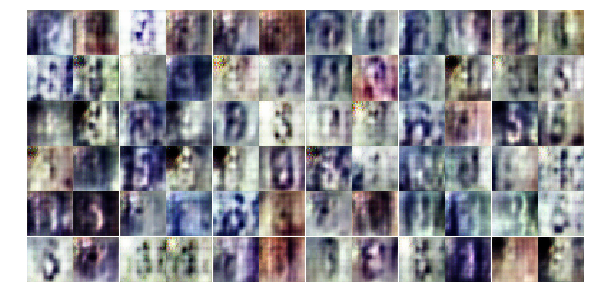

Epoch 3/100... Dloss: 0.2089 Gloss: 4.8747
Epoch 3/100... Dloss: -31.5554 Gloss: 41.1513
Epoch 3/100... Dloss: 9.1203 Gloss: 2.0911
Epoch 3/100... Dloss: 5.7794 Gloss: 22.7905
Epoch 3/100... Dloss: -13.4582 Gloss: 38.3904
Epoch 3/100... Dloss: 28.3009 Gloss: 25.5542
Epoch 3/100... Dloss: -0.1413 Gloss: 54.4571
Epoch 3/100... Dloss: 62.1528 Gloss: -9.8770
Epoch 3/100... Dloss: -20.0040 Gloss: 36.9833
Epoch 3/100... Dloss: -4.5303 Gloss: 50.8298


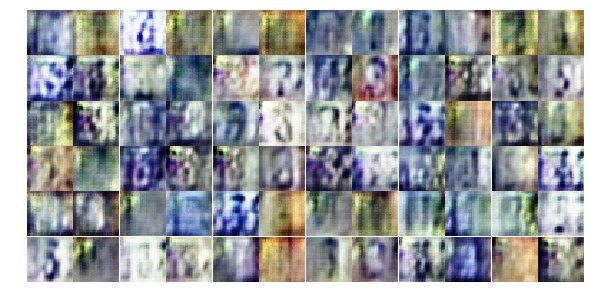

Epoch 3/100... Dloss: 20.6007 Gloss: 24.0166
Epoch 3/100... Dloss: -22.7700 Gloss: 68.1407
Epoch 3/100... Dloss: -75.2162 Gloss: 137.6867
Epoch 3/100... Dloss: -109.6752 Gloss: 181.0287
Epoch 3/100... Dloss: -13.1361 Gloss: 49.9959
Epoch 3/100... Dloss: -45.5194 Gloss: 124.7965
Epoch 3/100... Dloss: -241.3635 Gloss: 377.0278
Epoch 3/100... Dloss: -51.6022 Gloss: 261.6509
Epoch 3/100... Dloss: -24.6108 Gloss: 50.2147
Epoch 3/100... Dloss: -27.0352 Gloss: 50.3016


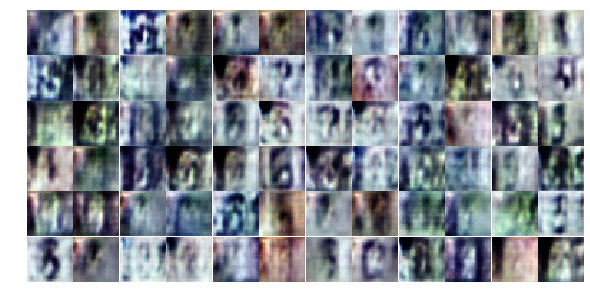

Epoch 3/100... Dloss: -22.4398 Gloss: 45.3006
(128, 100) (41, 32, 32, 3)
Epoch 4/100... Dloss: -78.0718 Gloss: 128.2558
Epoch 4/100... Dloss: -248.9243 Gloss: 386.9705
Epoch 4/100... Dloss: -279.5766 Gloss: 665.7394
Epoch 4/100... Dloss: -3.8795 Gloss: 184.7672
Epoch 4/100... Dloss: -86.0322 Gloss: 138.7985
Epoch 4/100... Dloss: -740.9374 Gloss: 800.3714
Epoch 4/100... Dloss: -162.6209 Gloss: 375.2668
Epoch 4/100... Dloss: -219.3289 Gloss: 329.8719
Epoch 4/100... Dloss: -399.5205 Gloss: 610.7166


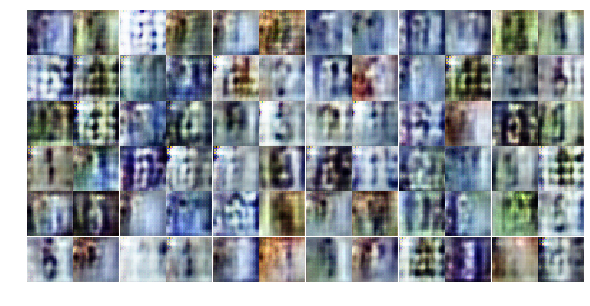

Epoch 4/100... Dloss: -98.9561 Gloss: 144.8345
Epoch 4/100... Dloss: 59.7193 Gloss: 485.2512
Epoch 4/100... Dloss: 80.0735 Gloss: 35.1186
Epoch 4/100... Dloss: -84.7848 Gloss: 127.9528
Epoch 4/100... Dloss: 137.1486 Gloss: -95.0027
Epoch 4/100... Dloss: -43.2430 Gloss: 100.1016
Epoch 4/100... Dloss: -46.9066 Gloss: 86.0139
Epoch 4/100... Dloss: 92.3175 Gloss: -46.9934
Epoch 4/100... Dloss: -162.3055 Gloss: 237.2925
Epoch 4/100... Dloss: -46.5889 Gloss: 165.9665


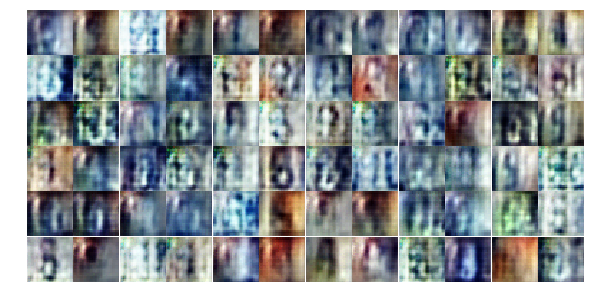

Epoch 4/100... Dloss: -132.0997 Gloss: 212.2491
Epoch 4/100... Dloss: -41.9610 Gloss: 90.6826
Epoch 4/100... Dloss: 59.2143 Gloss: -32.9199
Epoch 4/100... Dloss: -0.6465 Gloss: 9.0303
Epoch 4/100... Dloss: 2.4050 Gloss: 2.8860
Epoch 4/100... Dloss: -25.1494 Gloss: 34.3090
Epoch 4/100... Dloss: -165.8264 Gloss: 249.4568
Epoch 4/100... Dloss: -112.4737 Gloss: 535.8252
Epoch 4/100... Dloss: -269.3940 Gloss: 418.9691
Epoch 4/100... Dloss: 15.6639 Gloss: 87.4303


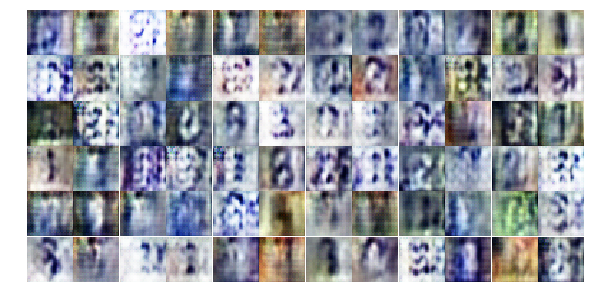

Epoch 4/100... Dloss: 168.4506 Gloss: -49.3976
Epoch 4/100... Dloss: -159.0436 Gloss: 278.7180
Epoch 4/100... Dloss: -107.0617 Gloss: 207.2210
Epoch 4/100... Dloss: -132.7375 Gloss: 209.3489
Epoch 4/100... Dloss: 3.3807 Gloss: 74.5073
Epoch 4/100... Dloss: -42.0060 Gloss: 130.7050
Epoch 4/100... Dloss: 73.3159 Gloss: 220.9849
Epoch 4/100... Dloss: -233.2517 Gloss: 419.4728
Epoch 4/100... Dloss: -135.8448 Gloss: 233.1300
Epoch 4/100... Dloss: -164.0194 Gloss: 332.5195


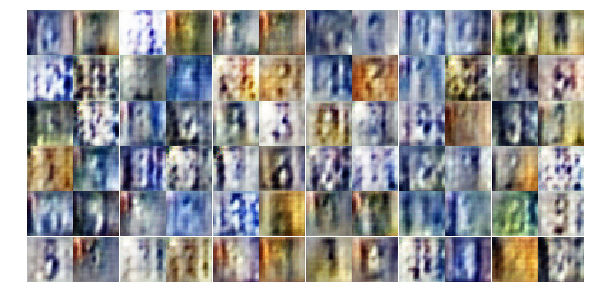

Epoch 4/100... Dloss: -3.4252 Gloss: 229.1228
Epoch 4/100... Dloss: -125.4575 Gloss: 331.3928
Epoch 4/100... Dloss: -222.9524 Gloss: 404.5006
Epoch 4/100... Dloss: -207.2873 Gloss: 306.0516
Epoch 4/100... Dloss: -130.0833 Gloss: 299.0389
Epoch 4/100... Dloss: -116.0264 Gloss: 207.9330
Epoch 4/100... Dloss: 84.3166 Gloss: -40.4169
Epoch 4/100... Dloss: -19.3019 Gloss: 55.1243
Epoch 4/100... Dloss: -140.7869 Gloss: 204.1513
Epoch 4/100... Dloss: 22.7797 Gloss: 89.9405


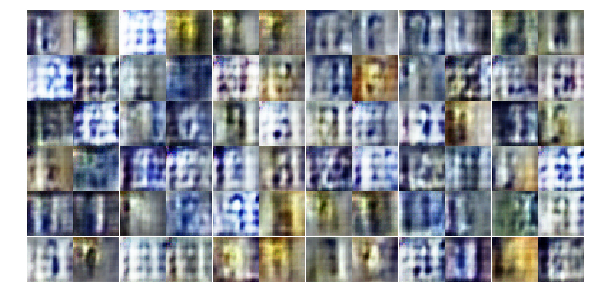

Epoch 4/100... Dloss: -116.4379 Gloss: 224.6083
Epoch 4/100... Dloss: -629.3066 Gloss: 258.5580
Epoch 4/100... Dloss: -60.5179 Gloss: 227.5258
Epoch 4/100... Dloss: -854.6351 Gloss: 1030.8013
Epoch 4/100... Dloss: -274.9564 Gloss: 467.5760
Epoch 4/100... Dloss: 41.1700 Gloss: 60.4511
Epoch 4/100... Dloss: -7.7206 Gloss: 92.0372
Epoch 4/100... Dloss: 34.1944 Gloss: 23.4438
(128, 100) (41, 32, 32, 3)
Epoch 5/100... Dloss: -101.3430 Gloss: 163.5697
Epoch 5/100... Dloss: 20.2456 Gloss: 22.3386


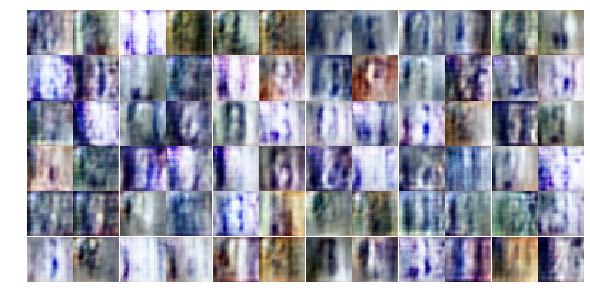

Epoch 5/100... Dloss: -242.0240 Gloss: 341.9699
Epoch 5/100... Dloss: -53.2907 Gloss: 189.1725
Epoch 5/100... Dloss: 32.9250 Gloss: 2.7442
Epoch 5/100... Dloss: 112.8151 Gloss: -91.3713
Epoch 5/100... Dloss: -32.5111 Gloss: 78.7251
Epoch 5/100... Dloss: -66.3949 Gloss: 96.5526
Epoch 5/100... Dloss: -6.5375 Gloss: 58.7719
Epoch 5/100... Dloss: -54.2645 Gloss: 78.8596
Epoch 5/100... Dloss: 117.5387 Gloss: -82.9835
Epoch 5/100... Dloss: -64.3565 Gloss: 107.4218


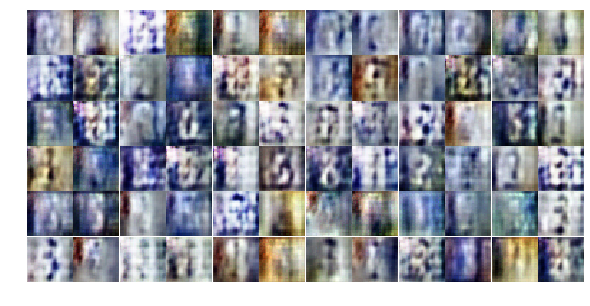

Epoch 5/100... Dloss: -69.0097 Gloss: 89.7906
Epoch 5/100... Dloss: 151.1884 Gloss: -124.4246
Epoch 5/100... Dloss: 22.4091 Gloss: 6.9542
Epoch 5/100... Dloss: -147.6415 Gloss: 174.0127
Epoch 5/100... Dloss: 40.4965 Gloss: -8.8864
Epoch 5/100... Dloss: 59.7706 Gloss: -37.7564
Epoch 5/100... Dloss: -12.4424 Gloss: 36.1103
Epoch 5/100... Dloss: -62.4218 Gloss: 83.8734
Epoch 5/100... Dloss: -25.2264 Gloss: 46.9183
Epoch 5/100... Dloss: -68.7827 Gloss: 98.8387


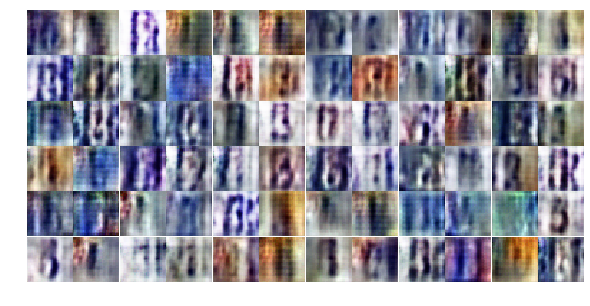

Epoch 5/100... Dloss: -36.2633 Gloss: 57.4308
Epoch 5/100... Dloss: 40.0102 Gloss: -21.7901
Epoch 5/100... Dloss: -17.4184 Gloss: 37.8765
Epoch 5/100... Dloss: 1.8550 Gloss: 18.4847
Epoch 5/100... Dloss: -23.0758 Gloss: 38.9185
Epoch 5/100... Dloss: -22.9923 Gloss: 40.0049
Epoch 5/100... Dloss: -72.1481 Gloss: 93.4510
Epoch 5/100... Dloss: 9.6697 Gloss: 8.6726
Epoch 5/100... Dloss: 21.2306 Gloss: -0.6628
Epoch 5/100... Dloss: -20.6601 Gloss: 38.8442


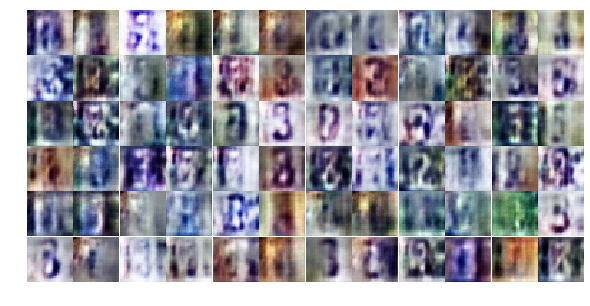

Epoch 5/100... Dloss: -32.8379 Gloss: 49.4314
Epoch 5/100... Dloss: 5.1160 Gloss: 12.5415
Epoch 5/100... Dloss: 19.1930 Gloss: 9.3871
Epoch 5/100... Dloss: -28.9966 Gloss: 47.5878
Epoch 5/100... Dloss: -4.3693 Gloss: 20.4038
Epoch 5/100... Dloss: -21.2820 Gloss: 35.0044
Epoch 5/100... Dloss: 1.5309 Gloss: 13.1559
Epoch 5/100... Dloss: -43.8905 Gloss: 60.7619
Epoch 5/100... Dloss: -9.4974 Gloss: 29.0147
Epoch 5/100... Dloss: -2.1678 Gloss: 19.7061


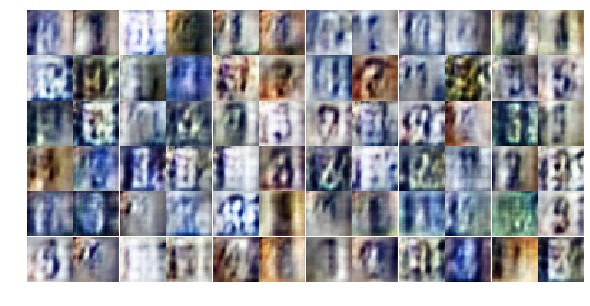

Epoch 5/100... Dloss: -49.7107 Gloss: 70.3686
Epoch 5/100... Dloss: -54.7256 Gloss: 73.5842
Epoch 5/100... Dloss: -19.2624 Gloss: 42.8496
Epoch 5/100... Dloss: -48.1030 Gloss: 88.6987
Epoch 5/100... Dloss: 6.3764 Gloss: 20.4671
Epoch 5/100... Dloss: -20.5577 Gloss: 39.6438
Epoch 5/100... Dloss: -8.9008 Gloss: 36.6188
Epoch 5/100... Dloss: -32.9389 Gloss: 55.8778
Epoch 5/100... Dloss: -1.1738 Gloss: 31.6042
Epoch 5/100... Dloss: -6.3912 Gloss: 43.8994


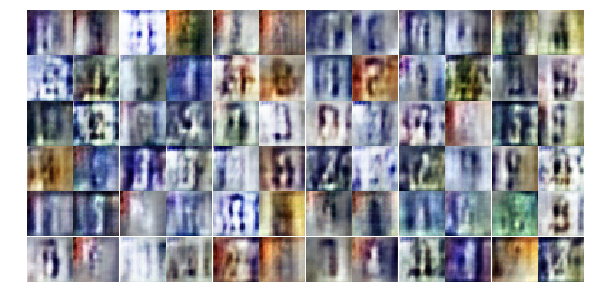

Epoch 5/100... Dloss: -19.5136 Gloss: 43.4764
Epoch 5/100... Dloss: -70.5586 Gloss: 112.1929
Epoch 5/100... Dloss: -56.9375 Gloss: 95.5212
Epoch 5/100... Dloss: -51.2460 Gloss: 90.5939
Epoch 5/100... Dloss: -204.3479 Gloss: 369.8744
Epoch 5/100... Dloss: -709.9067 Gloss: 885.0393
(128, 100) (41, 32, 32, 3)
Epoch 6/100... Dloss: -197.2301 Gloss: 183.7199
Epoch 6/100... Dloss: 23.4375 Gloss: 39.9606
Epoch 6/100... Dloss: -64.3150 Gloss: 111.3449
Epoch 6/100... Dloss: -122.5582 Gloss: 345.8499


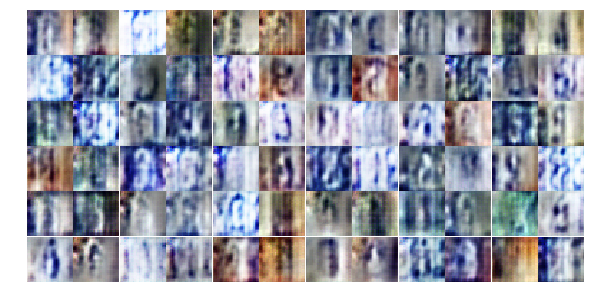

Epoch 6/100... Dloss: -410.2075 Gloss: 874.9789
Epoch 6/100... Dloss: -238.8044 Gloss: 421.5072
Epoch 6/100... Dloss: -573.4651 Gloss: 252.8874
Epoch 6/100... Dloss: -68.5976 Gloss: 102.2737
Epoch 6/100... Dloss: 6.9887 Gloss: 14.4851
Epoch 6/100... Dloss: -2.1162 Gloss: 29.6089
Epoch 6/100... Dloss: 14.6025 Gloss: 12.3470
Epoch 6/100... Dloss: -110.4917 Gloss: 172.8398
Epoch 6/100... Dloss: -152.7704 Gloss: 245.9494
Epoch 6/100... Dloss: 20.7846 Gloss: 37.9140


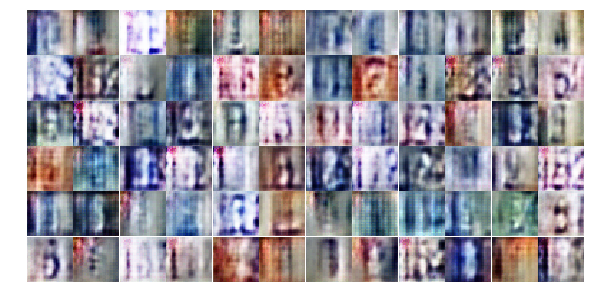

Epoch 6/100... Dloss: -70.6382 Gloss: 103.3083
Epoch 6/100... Dloss: -58.0014 Gloss: 131.3405
Epoch 6/100... Dloss: -10.1708 Gloss: 49.5290
Epoch 6/100... Dloss: -7.1832 Gloss: 99.6593
Epoch 6/100... Dloss: -21.7601 Gloss: 73.7542
Epoch 6/100... Dloss: -86.5374 Gloss: 133.5071
Epoch 6/100... Dloss: -25.1033 Gloss: 74.5326
Epoch 6/100... Dloss: -8.6533 Gloss: 54.2612
Epoch 6/100... Dloss: -63.5851 Gloss: 138.3404
Epoch 6/100... Dloss: -73.9177 Gloss: 167.8969


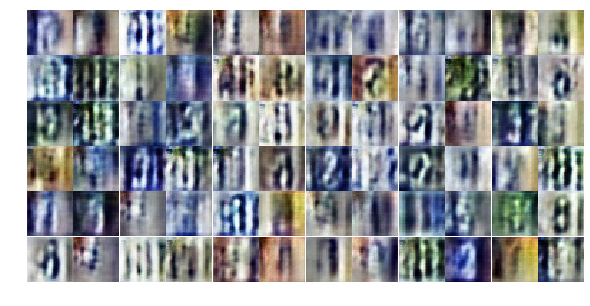

Epoch 6/100... Dloss: 11.5972 Gloss: 47.4093
Epoch 6/100... Dloss: -34.2891 Gloss: 83.3871
Epoch 6/100... Dloss: -13.3948 Gloss: 60.6366
Epoch 6/100... Dloss: -93.9900 Gloss: 137.7035
Epoch 6/100... Dloss: -77.3913 Gloss: 150.5391
Epoch 6/100... Dloss: -54.6077 Gloss: 140.9120
Epoch 6/100... Dloss: -86.0386 Gloss: 152.5998
Epoch 6/100... Dloss: -68.7272 Gloss: 216.0848
Epoch 6/100... Dloss: -143.8759 Gloss: 300.6278
Epoch 6/100... Dloss: -10.9496 Gloss: 119.3629


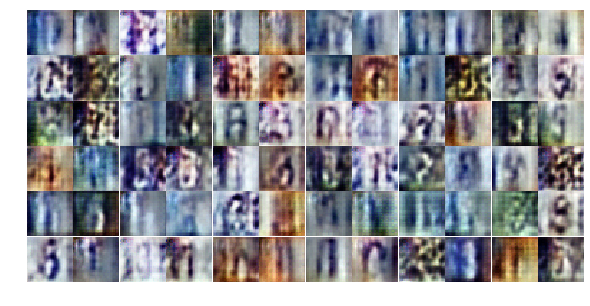

Epoch 6/100... Dloss: -16.6170 Gloss: 140.6440
Epoch 6/100... Dloss: -149.2741 Gloss: 290.1833
Epoch 6/100... Dloss: 7.8534 Gloss: 83.1791
Epoch 6/100... Dloss: -115.7261 Gloss: 241.7836
Epoch 6/100... Dloss: -59.4316 Gloss: 140.2263
Epoch 6/100... Dloss: -248.5845 Gloss: 381.2212
Epoch 6/100... Dloss: -121.7863 Gloss: 257.1904
Epoch 6/100... Dloss: -534.8522 Gloss: 1144.9656
Epoch 6/100... Dloss: 188.1682 Gloss: 352.6407
Epoch 6/100... Dloss: -111.9475 Gloss: 299.8940


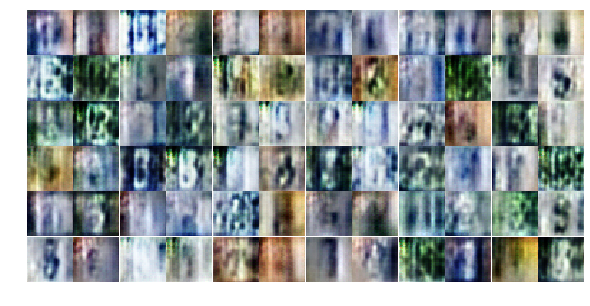

Epoch 6/100... Dloss: 5.9179 Gloss: 64.2910
Epoch 6/100... Dloss: -312.3764 Gloss: 430.3029
Epoch 6/100... Dloss: -191.4220 Gloss: 340.5674
Epoch 6/100... Dloss: -126.2309 Gloss: 202.7816
Epoch 6/100... Dloss: -58.6384 Gloss: 144.8414
Epoch 6/100... Dloss: -227.6352 Gloss: 397.2781
Epoch 6/100... Dloss: -851.3132 Gloss: 1007.0688
Epoch 6/100... Dloss: -797.3509 Gloss: 1098.4899
Epoch 6/100... Dloss: -381.5344 Gloss: 597.8771
Epoch 6/100... Dloss: -128.1434 Gloss: 255.3451


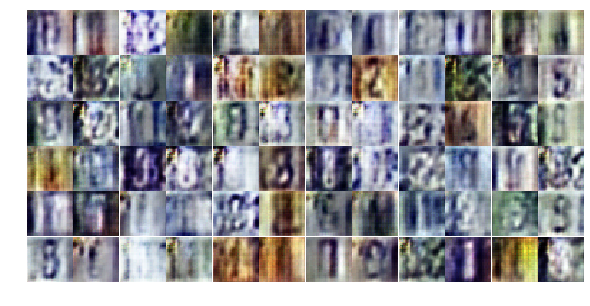

Epoch 6/100... Dloss: -431.7384 Gloss: 709.1455
Epoch 6/100... Dloss: -472.2098 Gloss: 1007.9071
Epoch 6/100... Dloss: -101.7082 Gloss: 178.5902
(128, 100) (41, 32, 32, 3)
Epoch 7/100... Dloss: -486.4775 Gloss: 637.9423
Epoch 7/100... Dloss: -125.3929 Gloss: 1287.7609
Epoch 7/100... Dloss: -70.3962 Gloss: 203.8545
Epoch 7/100... Dloss: -23.0634 Gloss: 57.8497
Epoch 7/100... Dloss: -112.5034 Gloss: 493.3687
Epoch 7/100... Dloss: -644.4865 Gloss: 892.8387
Epoch 7/100... Dloss: -1702.9314 Gloss: 1770.6204


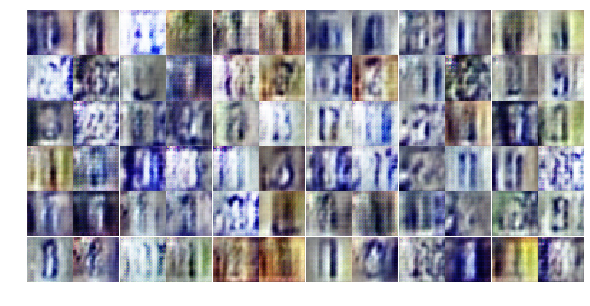

Epoch 7/100... Dloss: -51.3121 Gloss: 150.7719
Epoch 7/100... Dloss: -18.1818 Gloss: 66.0677
Epoch 7/100... Dloss: -41.9300 Gloss: 96.6935
Epoch 7/100... Dloss: -191.8068 Gloss: 548.7986
Epoch 7/100... Dloss: -216.1295 Gloss: 822.5653
Epoch 7/100... Dloss: -683.0773 Gloss: 385.5877
Epoch 7/100... Dloss: -95.4258 Gloss: 480.3205
Epoch 7/100... Dloss: 48.6945 Gloss: 109.0760
Epoch 7/100... Dloss: -557.6584 Gloss: 695.1016
Epoch 7/100... Dloss: -152.5975 Gloss: 429.4100


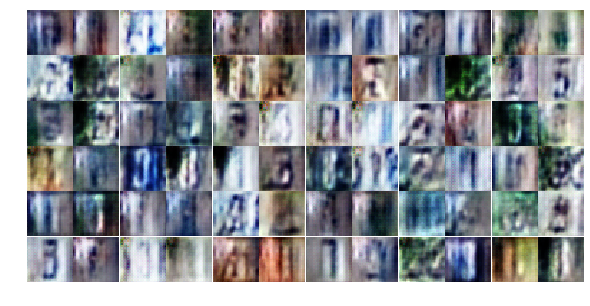

Epoch 7/100... Dloss: -151.7942 Gloss: 457.8638
Epoch 7/100... Dloss: -527.5765 Gloss: 546.6973
Epoch 7/100... Dloss: 135.9636 Gloss: 97.5703
Epoch 7/100... Dloss: -81.8637 Gloss: 138.0530
Epoch 7/100... Dloss: -41.9360 Gloss: 93.6243
Epoch 7/100... Dloss: -311.7781 Gloss: 521.9266
Epoch 7/100... Dloss: -1165.9504 Gloss: 1393.7485
Epoch 7/100... Dloss: -1049.6970 Gloss: 624.6733
Epoch 7/100... Dloss: -44.7046 Gloss: 152.8654
Epoch 7/100... Dloss: -26.8801 Gloss: 54.4368


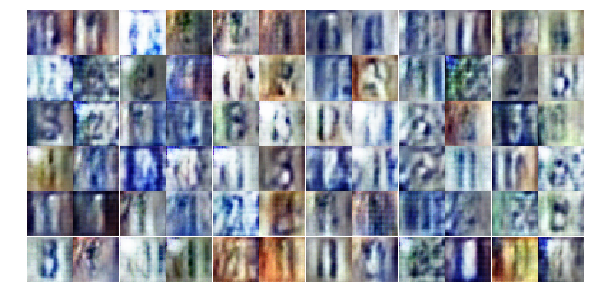

Epoch 7/100... Dloss: -3.1482 Gloss: 19.5188
Epoch 7/100... Dloss: -24.0315 Gloss: 46.7542
Epoch 7/100... Dloss: -134.1210 Gloss: 184.1639
Epoch 7/100... Dloss: -625.0671 Gloss: 930.0599
Epoch 7/100... Dloss: -1033.6534 Gloss: 1454.4858
Epoch 7/100... Dloss: -197.5838 Gloss: 802.9827
Epoch 7/100... Dloss: -397.1587 Gloss: 559.1996
Epoch 7/100... Dloss: -874.5834 Gloss: 1220.6644
Epoch 7/100... Dloss: -1235.3240 Gloss: 898.2944
Epoch 7/100... Dloss: -378.4438 Gloss: 1089.9817


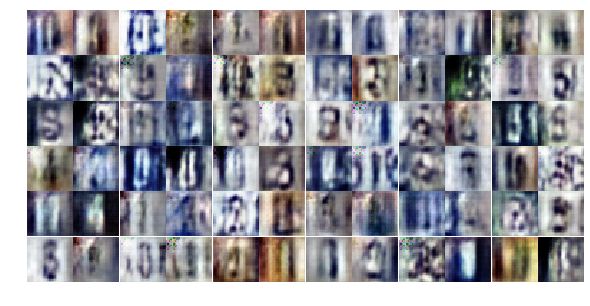

Epoch 7/100... Dloss: -957.2213 Gloss: 1238.3228
Epoch 7/100... Dloss: -387.1805 Gloss: 1301.8523
Epoch 7/100... Dloss: -681.9776 Gloss: 926.1317
Epoch 7/100... Dloss: -1090.5381 Gloss: 825.5220
Epoch 7/100... Dloss: -710.7593 Gloss: 1030.9032
Epoch 7/100... Dloss: -276.2515 Gloss: 1123.7378
Epoch 7/100... Dloss: -58.0193 Gloss: 168.6663
Epoch 7/100... Dloss: -11.7396 Gloss: 44.8515
Epoch 7/100... Dloss: -646.5134 Gloss: 833.2859
Epoch 7/100... Dloss: -157.1501 Gloss: 234.0107


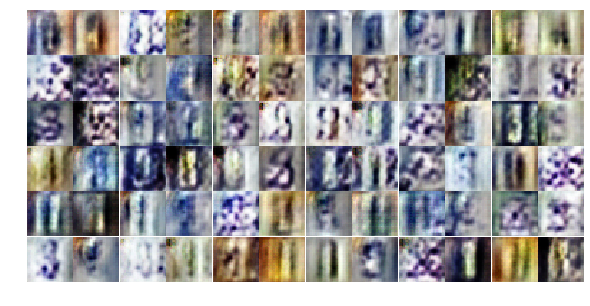

Epoch 7/100... Dloss: -161.1407 Gloss: 343.7999
Epoch 7/100... Dloss: -933.7890 Gloss: 998.7514
Epoch 7/100... Dloss: -1203.8285 Gloss: 768.8837
Epoch 7/100... Dloss: 158.7744 Gloss: 1217.6414
Epoch 7/100... Dloss: 2.0950 Gloss: 117.1447
Epoch 7/100... Dloss: -167.5298 Gloss: 302.8638
Epoch 7/100... Dloss: -902.8011 Gloss: 802.4326
Epoch 7/100... Dloss: -626.9763 Gloss: 1124.7872
Epoch 7/100... Dloss: -109.7997 Gloss: 1050.5419
Epoch 7/100... Dloss: -2089.6812 Gloss: 2259.5439


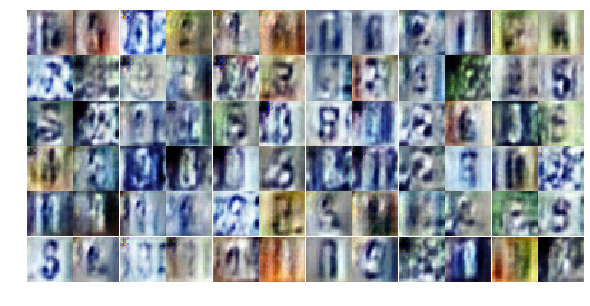

(128, 100) (41, 32, 32, 3)
Epoch 8/100... Dloss: -455.3377 Gloss: 808.9156
Epoch 8/100... Dloss: 17.5021 Gloss: 30.9580
Epoch 8/100... Dloss: -405.6633 Gloss: 657.6028
Epoch 8/100... Dloss: -1664.6061 Gloss: 1907.9233
Epoch 8/100... Dloss: -455.4032 Gloss: 1140.5773
Epoch 8/100... Dloss: -706.9437 Gloss: 1053.4481
Epoch 8/100... Dloss: -1020.8379 Gloss: 1939.8877
Epoch 8/100... Dloss: -2799.7273 Gloss: 2863.0103
Epoch 8/100... Dloss: -1737.8850 Gloss: 2239.6426
Epoch 8/100... Dloss: -1397.9062 Gloss: 466.3387


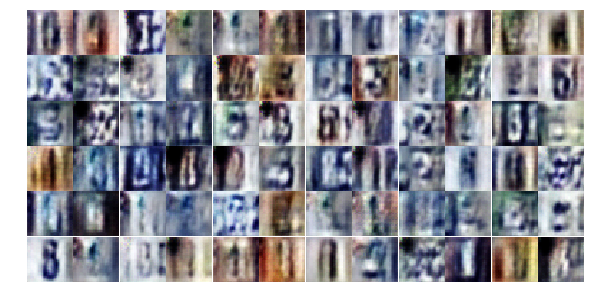

Epoch 8/100... Dloss: -282.0671 Gloss: 521.5631
Epoch 8/100... Dloss: -917.4780 Gloss: 1417.3802
Epoch 8/100... Dloss: -249.7997 Gloss: 563.5863
Epoch 8/100... Dloss: -1209.4764 Gloss: 2004.8524
Epoch 8/100... Dloss: -569.5995 Gloss: 1269.7415
Epoch 8/100... Dloss: -1150.6733 Gloss: 1966.7527
Epoch 8/100... Dloss: -1102.2450 Gloss: 1397.4727
Epoch 8/100... Dloss: -3162.9795 Gloss: 3240.4277
Epoch 8/100... Dloss: -1051.6296 Gloss: 1317.6870
Epoch 8/100... Dloss: -1893.1201 Gloss: 2394.9807


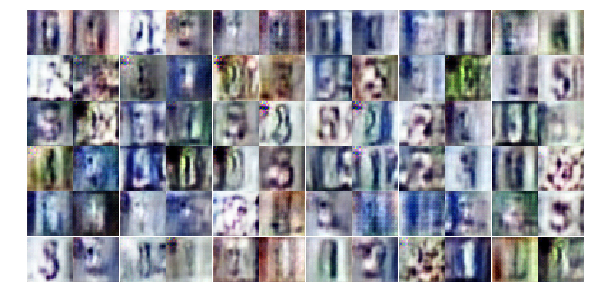

Epoch 8/100... Dloss: -2207.8394 Gloss: 2625.7693
Epoch 8/100... Dloss: -2356.4785 Gloss: 3145.7383
Epoch 8/100... Dloss: -805.3037 Gloss: 1205.9307
Epoch 8/100... Dloss: 208.5797 Gloss: 1455.0240
Epoch 8/100... Dloss: -106.2256 Gloss: 624.9763
Epoch 8/100... Dloss: -768.0494 Gloss: 1253.2103
Epoch 8/100... Dloss: -411.4723 Gloss: 750.0425
Epoch 8/100... Dloss: -785.5184 Gloss: 1082.2196
Epoch 8/100... Dloss: -220.6279 Gloss: 311.2347
Epoch 8/100... Dloss: -437.8510 Gloss: 607.9473


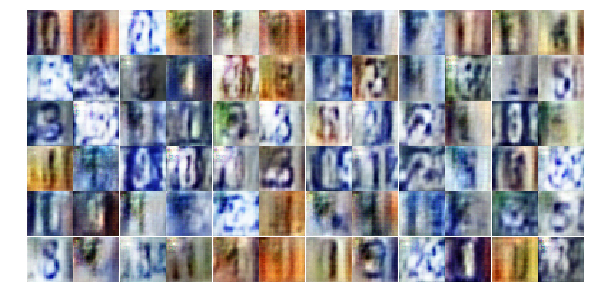

Epoch 8/100... Dloss: -1191.1819 Gloss: 1902.2620
Epoch 8/100... Dloss: -2013.9065 Gloss: 2220.7957
Epoch 8/100... Dloss: -1366.0471 Gloss: 1879.4277
Epoch 8/100... Dloss: -1723.6838 Gloss: 2117.0066
Epoch 8/100... Dloss: -328.9270 Gloss: 2075.9883
Epoch 8/100... Dloss: -10.7927 Gloss: 37.3799
Epoch 8/100... Dloss: -172.3844 Gloss: 217.0959
Epoch 8/100... Dloss: 35.7919 Gloss: 52.0809
Epoch 8/100... Dloss: -1080.0752 Gloss: 1760.1729
Epoch 8/100... Dloss: -381.5584 Gloss: 690.7365


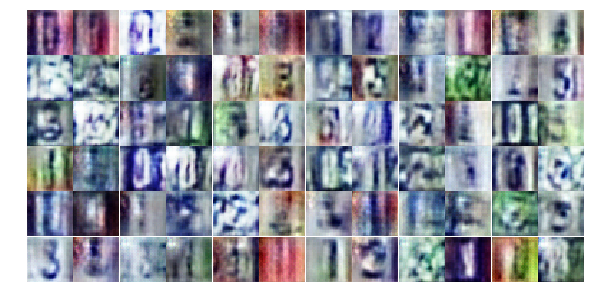

Epoch 8/100... Dloss: -731.2014 Gloss: 1193.8260
Epoch 8/100... Dloss: -235.6106 Gloss: 344.4844
Epoch 8/100... Dloss: -787.0014 Gloss: 1498.2078
Epoch 8/100... Dloss: -1249.2690 Gloss: 1334.1005
Epoch 8/100... Dloss: -1347.6090 Gloss: 1729.6520
Epoch 8/100... Dloss: -1155.0020 Gloss: 2032.4138
Epoch 8/100... Dloss: -1400.7883 Gloss: 3124.5583
Epoch 8/100... Dloss: -827.7500 Gloss: 1868.0425
Epoch 8/100... Dloss: -938.0265 Gloss: 1292.2087
Epoch 8/100... Dloss: -783.1299 Gloss: 1628.1550


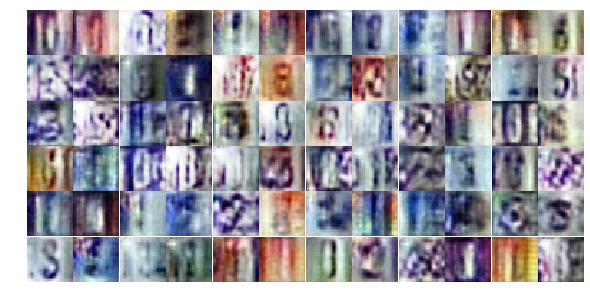

Epoch 8/100... Dloss: -3065.3311 Gloss: 3148.3586
Epoch 8/100... Dloss: -2632.3276 Gloss: 2096.8667
Epoch 8/100... Dloss: -860.6407 Gloss: 1768.3625
Epoch 8/100... Dloss: -755.7916 Gloss: 1189.5509
Epoch 8/100... Dloss: -997.3274 Gloss: 1338.5574
Epoch 8/100... Dloss: -1932.5619 Gloss: 2754.1982
Epoch 8/100... Dloss: -937.9155 Gloss: 2221.8567
(128, 100) (41, 32, 32, 3)
Epoch 9/100... Dloss: -1734.1311 Gloss: 2178.8508
Epoch 9/100... Dloss: -354.9319 Gloss: 692.9197
Epoch 9/100... Dloss: -1598.7474 Gloss: 2637.7524


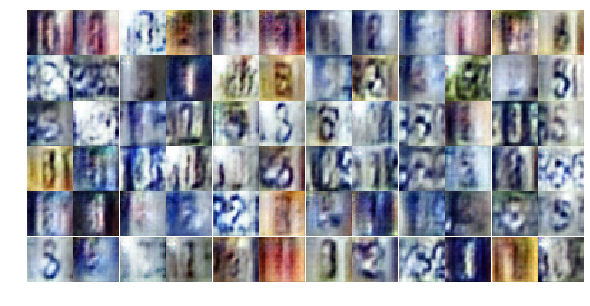

Epoch 9/100... Dloss: -3496.4561 Gloss: 2091.9253
Epoch 9/100... Dloss: -258.0134 Gloss: 425.8850
Epoch 9/100... Dloss: -2178.1934 Gloss: 2678.9780
Epoch 9/100... Dloss: -1796.5887 Gloss: 2422.8901
Epoch 9/100... Dloss: -123.0797 Gloss: 448.6078
Epoch 9/100... Dloss: -3675.4043 Gloss: 3911.8293
Epoch 9/100... Dloss: -1157.3621 Gloss: 2708.9224
Epoch 9/100... Dloss: -2442.2007 Gloss: 3164.1729
Epoch 9/100... Dloss: -3357.7839 Gloss: 3607.8171
Epoch 9/100... Dloss: -552.1869 Gloss: 1042.5132


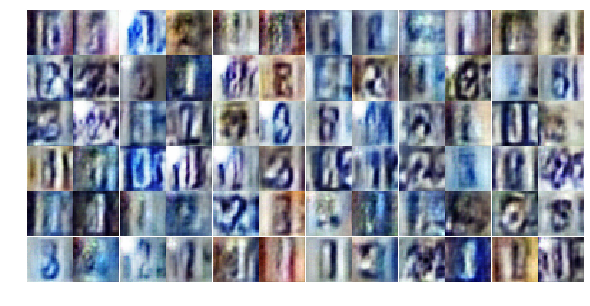

Epoch 9/100... Dloss: -2426.2310 Gloss: 2719.1814
Epoch 9/100... Dloss: -607.3811 Gloss: 1499.6506
Epoch 9/100... Dloss: -1261.5862 Gloss: 1773.4700
Epoch 9/100... Dloss: -1593.2228 Gloss: 2590.6455
Epoch 9/100... Dloss: -1224.7844 Gloss: 1662.1118
Epoch 9/100... Dloss: -1361.9800 Gloss: 2352.7192
Epoch 9/100... Dloss: -1162.8580 Gloss: 2753.3135
Epoch 9/100... Dloss: -1444.8101 Gloss: 2379.6545
Epoch 9/100... Dloss: -1234.8926 Gloss: 1783.3234
Epoch 9/100... Dloss: 796.5375 Gloss: 2417.7766


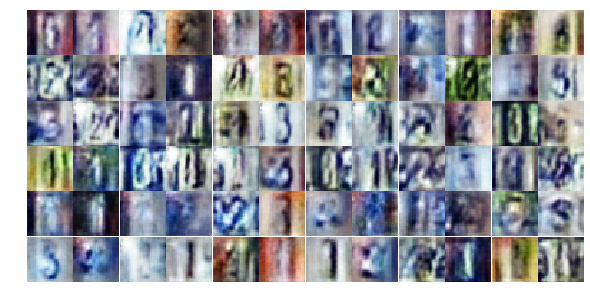

Epoch 9/100... Dloss: -1648.5197 Gloss: 2611.6709
Epoch 9/100... Dloss: -2122.4014 Gloss: 2958.6245
Epoch 9/100... Dloss: -984.4284 Gloss: 1366.2800
Epoch 9/100... Dloss: -1491.1204 Gloss: 2230.7754
Epoch 9/100... Dloss: -2169.4639 Gloss: 550.2886
Epoch 9/100... Dloss: -382.4031 Gloss: 633.4978
Epoch 9/100... Dloss: -651.2053 Gloss: 1583.9056
Epoch 9/100... Dloss: -765.4504 Gloss: 2115.6099
Epoch 9/100... Dloss: -526.8656 Gloss: 839.0856
Epoch 9/100... Dloss: 498.1209 Gloss: 1284.9999


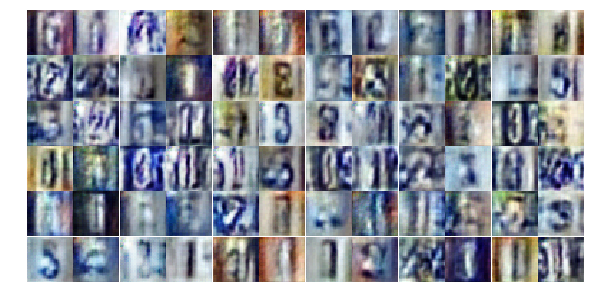

Epoch 9/100... Dloss: -1885.4644 Gloss: 2282.0134
Epoch 9/100... Dloss: -1570.7263 Gloss: 1933.9836
Epoch 9/100... Dloss: -887.6925 Gloss: 1539.0988
Epoch 9/100... Dloss: -991.3912 Gloss: 2243.1416
Epoch 9/100... Dloss: -1842.4250 Gloss: 2125.3169
Epoch 9/100... Dloss: -1546.3696 Gloss: 2078.3086
Epoch 9/100... Dloss: -1706.5015 Gloss: 2702.2166
Epoch 9/100... Dloss: -1154.0841 Gloss: 1955.3101
Epoch 9/100... Dloss: -954.5543 Gloss: 1611.3754
Epoch 9/100... Dloss: -380.6574 Gloss: 648.5230


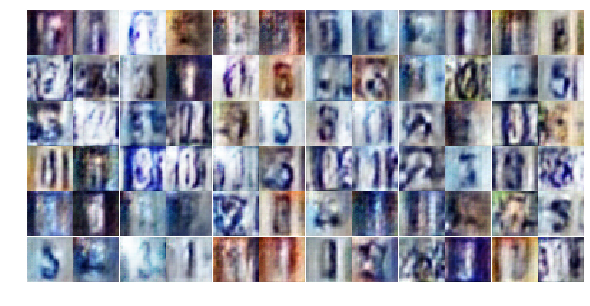

Epoch 9/100... Dloss: -1178.2704 Gloss: 1632.6907
Epoch 9/100... Dloss: -1037.6523 Gloss: 1832.2896
Epoch 9/100... Dloss: -1304.4653 Gloss: 2093.7349
Epoch 9/100... Dloss: -1499.1904 Gloss: 1877.2683
Epoch 9/100... Dloss: -628.6318 Gloss: 1224.8119
Epoch 9/100... Dloss: -2730.8196 Gloss: 3434.1538
Epoch 9/100... Dloss: -2097.1729 Gloss: 2487.7510
Epoch 9/100... Dloss: -974.7704 Gloss: 2136.0083
Epoch 9/100... Dloss: -1790.7737 Gloss: 2729.5498
Epoch 9/100... Dloss: -1087.5784 Gloss: 1819.2163


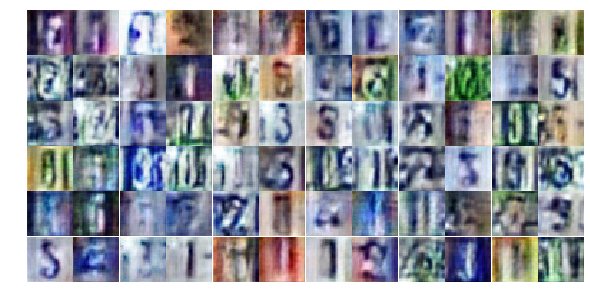

Epoch 9/100... Dloss: -2683.3335 Gloss: 3672.7893
Epoch 9/100... Dloss: -1780.4897 Gloss: 2355.1704
Epoch 9/100... Dloss: -885.2932 Gloss: 2221.0205
Epoch 9/100... Dloss: -1233.6409 Gloss: 1750.9006
(128, 100) (41, 32, 32, 3)
Epoch 10/100... Dloss: -1024.5327 Gloss: 1757.4232
Epoch 10/100... Dloss: -771.8618 Gloss: 2321.1675
Epoch 10/100... Dloss: -2123.7786 Gloss: 2678.8503
Epoch 10/100... Dloss: -1251.8354 Gloss: 1707.4224
Epoch 10/100... Dloss: -2011.9243 Gloss: 1685.7485
Epoch 10/100... Dloss: -1000.9130 Gloss: 1686.6420


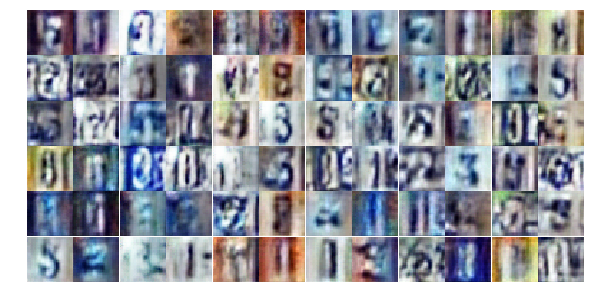

Epoch 10/100... Dloss: -1429.9419 Gloss: 1666.4760
Epoch 10/100... Dloss: -1180.4270 Gloss: 1973.8257
Epoch 10/100... Dloss: -1376.2552 Gloss: 2057.7168
Epoch 10/100... Dloss: -108.8425 Gloss: 137.0487
Epoch 10/100... Dloss: 141.0160 Gloss: 2.4675
Epoch 10/100... Dloss: -88.0243 Gloss: 149.9396
Epoch 10/100... Dloss: -519.3427 Gloss: 799.1606
Epoch 10/100... Dloss: -2357.8748 Gloss: 2987.2058
Epoch 10/100... Dloss: -76.9296 Gloss: 98.5014
Epoch 10/100... Dloss: -177.2484 Gloss: 483.2991


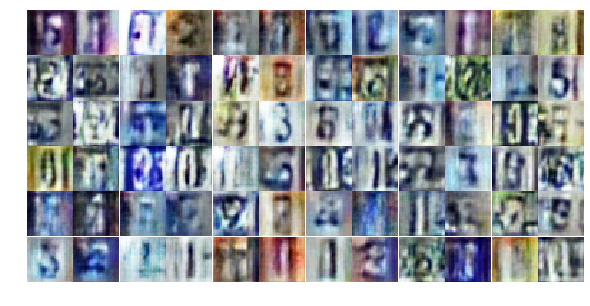

Epoch 10/100... Dloss: 437.0530 Gloss: 250.6414
Epoch 10/100... Dloss: -1545.6383 Gloss: 2306.5176
Epoch 10/100... Dloss: -238.8017 Gloss: 1082.4814
Epoch 10/100... Dloss: -1919.6387 Gloss: 2901.7939
Epoch 10/100... Dloss: -1858.1315 Gloss: 2999.1865
Epoch 10/100... Dloss: -0.4324 Gloss: 1806.1652
Epoch 10/100... Dloss: -1982.9824 Gloss: 2463.6882
Epoch 10/100... Dloss: -1868.2017 Gloss: 2323.8442
Epoch 10/100... Dloss: -562.4009 Gloss: 1214.3655
Epoch 10/100... Dloss: -1122.5732 Gloss: 3015.3762


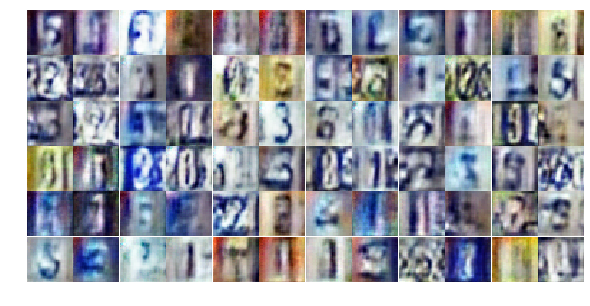

Epoch 10/100... Dloss: -1224.4895 Gloss: 1941.5272
Epoch 10/100... Dloss: -2438.0854 Gloss: 3317.6714
Epoch 10/100... Dloss: -1805.5391 Gloss: 2644.8774
Epoch 10/100... Dloss: -1398.5164 Gloss: 2054.7861
Epoch 10/100... Dloss: -2825.8269 Gloss: 3312.2249
Epoch 10/100... Dloss: -180.8541 Gloss: 214.1463
Epoch 10/100... Dloss: -250.3550 Gloss: 415.6292
Epoch 10/100... Dloss: -1144.2067 Gloss: 1936.2268
Epoch 10/100... Dloss: -698.5225 Gloss: 1330.4932
Epoch 10/100... Dloss: -1105.4658 Gloss: 2680.7917


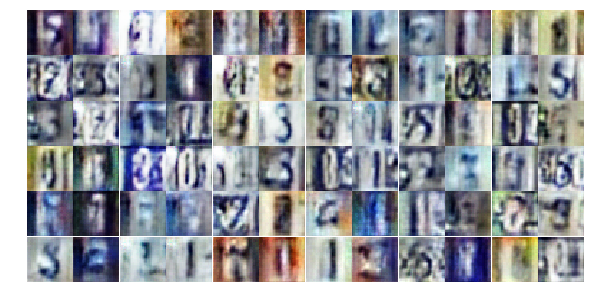

Epoch 10/100... Dloss: -1469.2035 Gloss: 2185.3931
Epoch 10/100... Dloss: -1454.1865 Gloss: 2305.5430
Epoch 10/100... Dloss: -882.7413 Gloss: 1905.4406
Epoch 10/100... Dloss: -2261.2515 Gloss: 2510.2344
Epoch 10/100... Dloss: -2741.9895 Gloss: 3873.8083
Epoch 10/100... Dloss: -1333.4951 Gloss: 2590.7959
Epoch 10/100... Dloss: -843.2970 Gloss: 4172.7866
Epoch 10/100... Dloss: -1078.7190 Gloss: 1917.5837
Epoch 10/100... Dloss: -1063.4504 Gloss: 1690.9586
Epoch 10/100... Dloss: -3127.5737 Gloss: 1571.9481


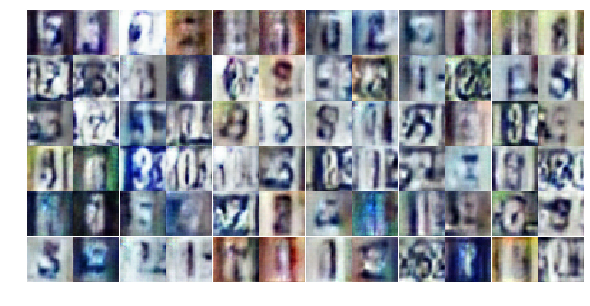

Epoch 10/100... Dloss: -1161.9861 Gloss: 2953.9712
Epoch 10/100... Dloss: -1556.5518 Gloss: 2967.1033
Epoch 10/100... Dloss: -1638.5776 Gloss: 2685.1575
Epoch 10/100... Dloss: -1670.1719 Gloss: 2758.2173
Epoch 10/100... Dloss: -2783.2349 Gloss: 3406.9868
Epoch 10/100... Dloss: -2487.3140 Gloss: 3277.0527
Epoch 10/100... Dloss: -1844.3259 Gloss: 2713.4539
Epoch 10/100... Dloss: -1775.8871 Gloss: 2901.7056
Epoch 10/100... Dloss: -1363.1371 Gloss: 2083.5291
Epoch 10/100... Dloss: -1403.6512 Gloss: 2378.4695


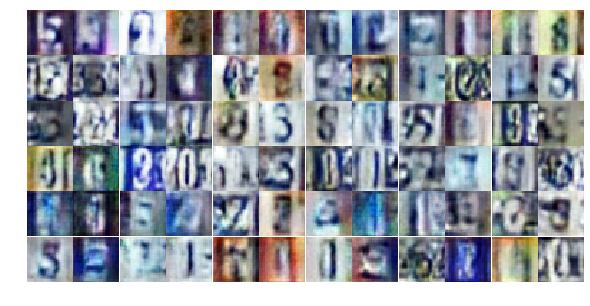

Epoch 10/100... Dloss: -1024.2510 Gloss: 2885.8794
Epoch 10/100... Dloss: -2275.9702 Gloss: 2400.6328
(128, 100) (41, 32, 32, 3)
Epoch 11/100... Dloss: -1618.5641 Gloss: 2337.0454
Epoch 11/100... Dloss: -2181.5918 Gloss: 2976.6523
Epoch 11/100... Dloss: -650.8181 Gloss: 2187.1201
Epoch 11/100... Dloss: -1717.0016 Gloss: 2983.0586
Epoch 11/100... Dloss: -105.6237 Gloss: 1576.6101
Epoch 11/100... Dloss: -2333.3652 Gloss: 3008.7983
Epoch 11/100... Dloss: -2604.1611 Gloss: 2442.3198
Epoch 11/100... Dloss: -1564.1763 Gloss: 2398.4426


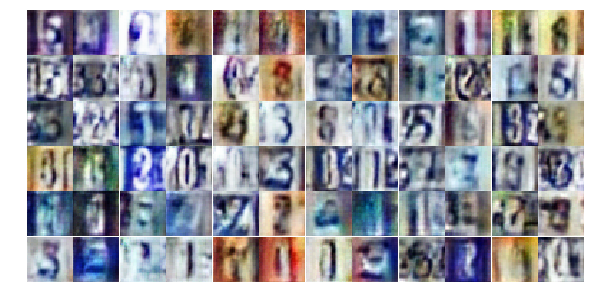

Epoch 11/100... Dloss: -1231.9778 Gloss: 2305.0703
Epoch 11/100... Dloss: -1700.9243 Gloss: 2942.3335
Epoch 11/100... Dloss: -2068.5088 Gloss: 3055.0234
Epoch 11/100... Dloss: -1428.0132 Gloss: 2144.0234
Epoch 11/100... Dloss: -1397.1091 Gloss: 2402.4028
Epoch 11/100... Dloss: -1693.3564 Gloss: 2586.0625
Epoch 11/100... Dloss: -2193.1479 Gloss: 3361.7168
Epoch 11/100... Dloss: -2254.8984 Gloss: 2537.2842
Epoch 11/100... Dloss: -1234.2153 Gloss: 1869.9208
Epoch 11/100... Dloss: -2373.1992 Gloss: 3996.5229


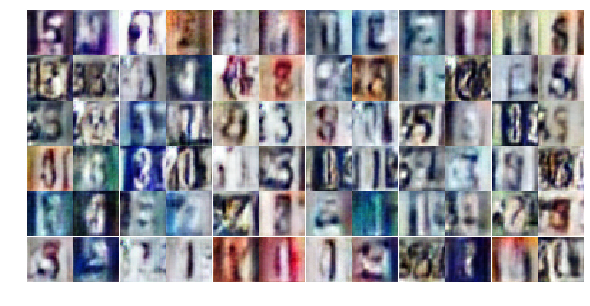

Epoch 11/100... Dloss: -409.3452 Gloss: 694.8368
Epoch 11/100... Dloss: -1534.3262 Gloss: 2453.9155
Epoch 11/100... Dloss: -2137.9099 Gloss: 3150.9226
Epoch 11/100... Dloss: -582.8398 Gloss: 1505.5078
Epoch 11/100... Dloss: -1219.0903 Gloss: 2172.1226
Epoch 11/100... Dloss: -1809.7218 Gloss: 2570.8838
Epoch 11/100... Dloss: -2579.0479 Gloss: 3280.0947
Epoch 11/100... Dloss: -1242.0674 Gloss: 2232.0884
Epoch 11/100... Dloss: -1482.1503 Gloss: 2280.7319
Epoch 11/100... Dloss: -5035.9414 Gloss: 4075.0640


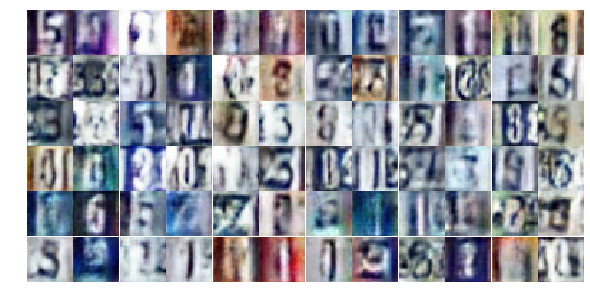

Epoch 11/100... Dloss: -335.9776 Gloss: 285.3978
Epoch 11/100... Dloss: -1061.4846 Gloss: 1775.8835
Epoch 11/100... Dloss: -924.1794 Gloss: 1706.5302
Epoch 11/100... Dloss: -1836.5940 Gloss: 2826.2349
Epoch 11/100... Dloss: -1303.1191 Gloss: 2289.9897
Epoch 11/100... Dloss: -2378.1421 Gloss: 4011.1094
Epoch 11/100... Dloss: -1338.2004 Gloss: 2709.8489
Epoch 11/100... Dloss: -1925.6416 Gloss: 3011.7371
Epoch 11/100... Dloss: -3198.0583 Gloss: 4771.9102
Epoch 11/100... Dloss: -1767.4136 Gloss: 2966.0562


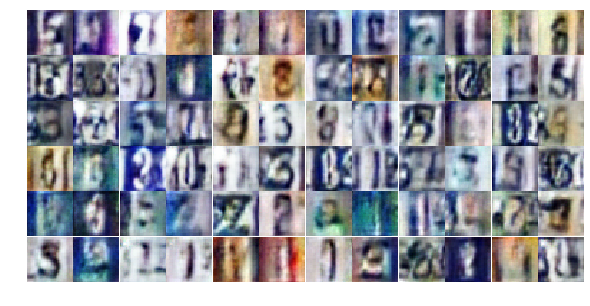

Epoch 11/100... Dloss: -2362.9751 Gloss: 3502.2471
Epoch 11/100... Dloss: -1293.6367 Gloss: 2437.8999
Epoch 11/100... Dloss: -3510.8271 Gloss: 1263.7651
Epoch 11/100... Dloss: -1700.8853 Gloss: 3451.6912
Epoch 11/100... Dloss: -1286.8453 Gloss: 3056.4922
Epoch 11/100... Dloss: -1719.0085 Gloss: 3205.2651
Epoch 11/100... Dloss: -2138.8711 Gloss: 3785.5652
Epoch 11/100... Dloss: -769.8332 Gloss: 1998.3389
Epoch 11/100... Dloss: -2545.1719 Gloss: 3286.3542
Epoch 11/100... Dloss: -2050.5056 Gloss: 2870.4209


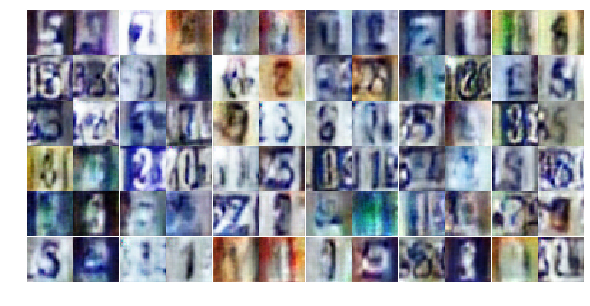

Epoch 11/100... Dloss: -1512.1471 Gloss: 2729.0176
Epoch 11/100... Dloss: -1154.3778 Gloss: 1619.4946
Epoch 11/100... Dloss: -4097.4326 Gloss: 4992.6245
Epoch 11/100... Dloss: -1491.4467 Gloss: 3229.6372
Epoch 11/100... Dloss: -2365.4314 Gloss: 2954.3491
Epoch 11/100... Dloss: -1415.6604 Gloss: 2576.8188
Epoch 11/100... Dloss: -2721.4153 Gloss: 3429.7739
Epoch 11/100... Dloss: -1841.9410 Gloss: 2542.4175
Epoch 11/100... Dloss: -1875.6018 Gloss: 3234.2788
(128, 100) (41, 32, 32, 3)
Epoch 12/100... Dloss: -1650.1310 Gloss: 2866.6604


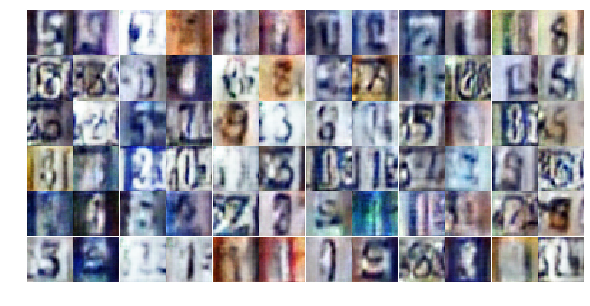

Epoch 12/100... Dloss: -1960.0924 Gloss: 2918.5078
Epoch 12/100... Dloss: -1863.8572 Gloss: 2347.9556
Epoch 12/100... Dloss: -2173.6248 Gloss: 2652.4661
Epoch 12/100... Dloss: -1699.9045 Gloss: 3974.7507
Epoch 12/100... Dloss: -2274.2651 Gloss: 2909.1394
Epoch 12/100... Dloss: -1697.6611 Gloss: 2696.2419
Epoch 12/100... Dloss: -992.6949 Gloss: 3483.2100
Epoch 12/100... Dloss: -1563.3174 Gloss: 2828.5713
Epoch 12/100... Dloss: -4786.5527 Gloss: 7047.4067
Epoch 12/100... Dloss: -1382.2065 Gloss: 2704.5630


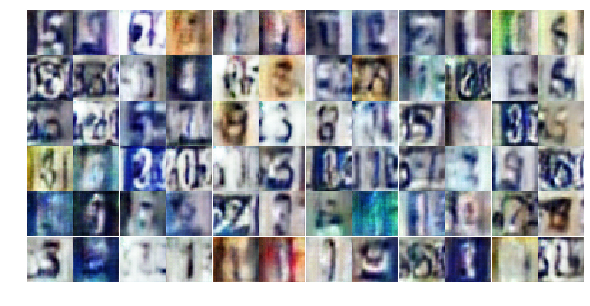

Epoch 12/100... Dloss: -865.3663 Gloss: 2240.4619
Epoch 12/100... Dloss: -1348.0605 Gloss: 3099.2529
Epoch 12/100... Dloss: -1498.1564 Gloss: 3521.5203
Epoch 12/100... Dloss: -1939.5159 Gloss: 3264.0564
Epoch 12/100... Dloss: -1622.8041 Gloss: 2438.7798
Epoch 12/100... Dloss: -1211.2356 Gloss: 2106.3394
Epoch 12/100... Dloss: -2676.2505 Gloss: 3938.2566
Epoch 12/100... Dloss: -2558.3662 Gloss: 3957.4553
Epoch 12/100... Dloss: -664.3382 Gloss: 2285.1726
Epoch 12/100... Dloss: -2596.1309 Gloss: 3520.7781


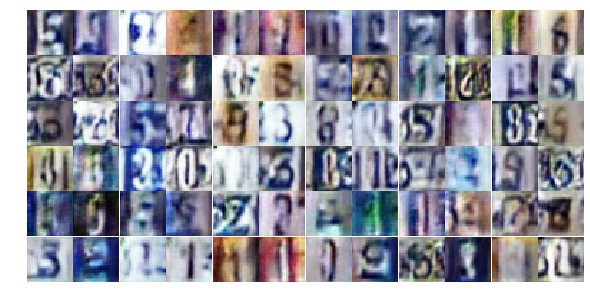

Epoch 12/100... Dloss: -1356.7844 Gloss: 3139.7236
Epoch 12/100... Dloss: -2109.2517 Gloss: 3870.8271
Epoch 12/100... Dloss: -2584.1304 Gloss: 3033.5371
Epoch 12/100... Dloss: -2301.5127 Gloss: 3115.6829
Epoch 12/100... Dloss: -453.7797 Gloss: 1556.4258
Epoch 12/100... Dloss: -337.4309 Gloss: 4893.5352
Epoch 12/100... Dloss: -1172.1877 Gloss: 2316.8608
Epoch 12/100... Dloss: -1695.4288 Gloss: 2435.8145
Epoch 12/100... Dloss: -2228.2603 Gloss: 3150.1592
Epoch 12/100... Dloss: -2627.3594 Gloss: 3682.5610


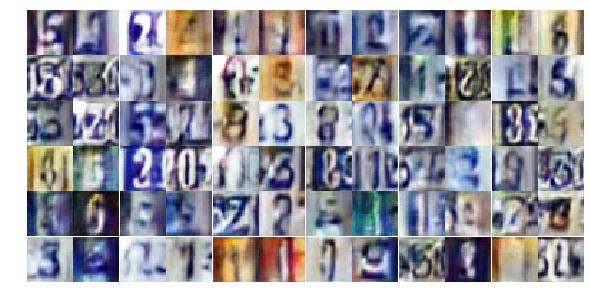

Epoch 12/100... Dloss: -1677.6863 Gloss: 2578.9045
Epoch 12/100... Dloss: -2207.7908 Gloss: 3235.8804
Epoch 12/100... Dloss: -1985.4211 Gloss: 2882.0132
Epoch 12/100... Dloss: -2018.5759 Gloss: 3312.0972
Epoch 12/100... Dloss: -2582.9092 Gloss: 2845.1289
Epoch 12/100... Dloss: -433.7823 Gloss: 1357.8301
Epoch 12/100... Dloss: -2161.5510 Gloss: 2660.0713
Epoch 12/100... Dloss: -3258.3545 Gloss: 4248.4517
Epoch 12/100... Dloss: -2392.4839 Gloss: 4766.5752
Epoch 12/100... Dloss: -1938.0352 Gloss: 3466.7317


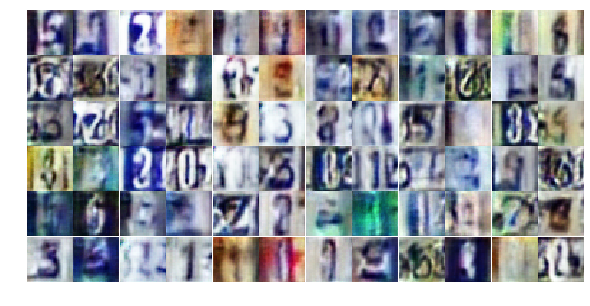

Epoch 12/100... Dloss: -3530.1377 Gloss: 5143.8740
Epoch 12/100... Dloss: -1588.3040 Gloss: 2196.9758
Epoch 12/100... Dloss: -679.8798 Gloss: 4952.4536
Epoch 12/100... Dloss: -1791.9888 Gloss: 3230.8506
Epoch 12/100... Dloss: -1425.9401 Gloss: 2380.3748
Epoch 12/100... Dloss: -2040.6853 Gloss: 3509.5679
Epoch 12/100... Dloss: -2834.5959 Gloss: 3650.1001
Epoch 12/100... Dloss: -3374.8398 Gloss: 4209.8359
Epoch 12/100... Dloss: -2444.6187 Gloss: 2988.5415
Epoch 12/100... Dloss: -3254.6951 Gloss: 4609.2373


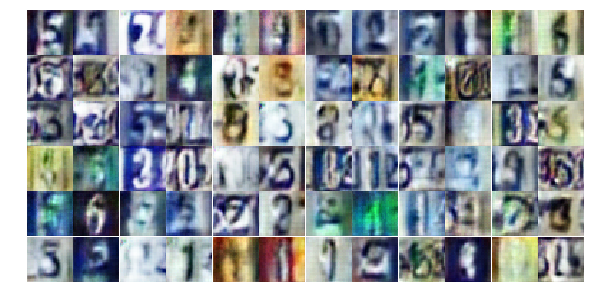

Epoch 12/100... Dloss: -1120.1476 Gloss: 2004.4224
Epoch 12/100... Dloss: -1839.1699 Gloss: 3059.6465
Epoch 12/100... Dloss: -1891.7035 Gloss: 4126.3809
Epoch 12/100... Dloss: -2332.5317 Gloss: 2852.5225
Epoch 12/100... Dloss: -2390.2620 Gloss: 3753.3608
Epoch 12/100... Dloss: -1481.2103 Gloss: 2518.3252
(128, 100) (41, 32, 32, 3)
Epoch 13/100... Dloss: -2452.3220 Gloss: 2957.7441
Epoch 13/100... Dloss: -1467.7878 Gloss: 2425.2246
Epoch 13/100... Dloss: -1747.7781 Gloss: 2637.0962
Epoch 13/100... Dloss: -1470.0092 Gloss: 4916.8770


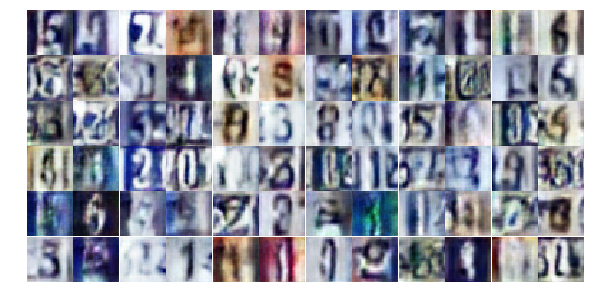

Epoch 13/100... Dloss: -1503.1259 Gloss: 2584.2065
Epoch 13/100... Dloss: -1405.2169 Gloss: 2628.7896
Epoch 13/100... Dloss: -3194.1504 Gloss: 4148.0820
Epoch 13/100... Dloss: -2059.3179 Gloss: 3312.7275
Epoch 13/100... Dloss: -2368.7825 Gloss: 3627.4421
Epoch 13/100... Dloss: -3589.6042 Gloss: 4918.4849
Epoch 13/100... Dloss: 5.3767 Gloss: 153.4593
Epoch 13/100... Dloss: -253.2130 Gloss: 485.9342
Epoch 13/100... Dloss: -953.5284 Gloss: 1859.1661
Epoch 13/100... Dloss: -1798.5978 Gloss: 2976.3560


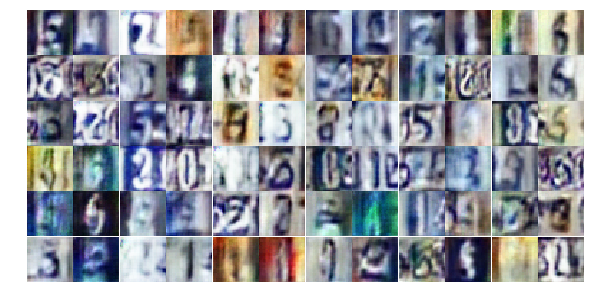

Epoch 13/100... Dloss: -1361.4934 Gloss: 2253.8071
Epoch 13/100... Dloss: -3067.0830 Gloss: 1566.9910
Epoch 13/100... Dloss: -1776.4352 Gloss: 3572.6787
Epoch 13/100... Dloss: -1630.8425 Gloss: 2938.5356
Epoch 13/100... Dloss: -3156.1306 Gloss: 4263.7866
Epoch 13/100... Dloss: -1823.2694 Gloss: 3719.1567
Epoch 13/100... Dloss: -721.5492 Gloss: 2021.5083
Epoch 13/100... Dloss: -3034.7310 Gloss: 3872.7888
Epoch 13/100... Dloss: -2443.0566 Gloss: 3454.9062
Epoch 13/100... Dloss: -2856.6160 Gloss: 4279.2725


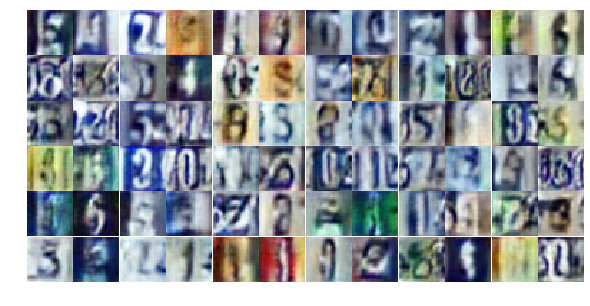

Epoch 13/100... Dloss: -2817.2925 Gloss: 4074.9326
Epoch 13/100... Dloss: -5994.2578 Gloss: 4501.3418
Epoch 13/100... Dloss: -500.6204 Gloss: 701.1653
Epoch 13/100... Dloss: -2193.3203 Gloss: 3361.3096
Epoch 13/100... Dloss: -1214.3120 Gloss: 2142.6189
Epoch 13/100... Dloss: -4525.0244 Gloss: 5345.9590
Epoch 13/100... Dloss: -943.0331 Gloss: 1709.7761
Epoch 13/100... Dloss: -2805.2815 Gloss: 4902.3486
Epoch 13/100... Dloss: -2922.2393 Gloss: 3796.5127
Epoch 13/100... Dloss: -3445.0605 Gloss: 4686.9785


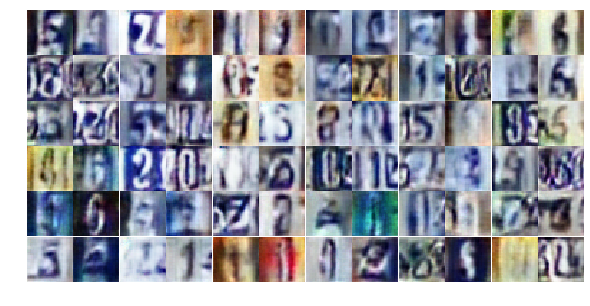

Epoch 13/100... Dloss: -209.5204 Gloss: 1510.2153
Epoch 13/100... Dloss: -3452.8745 Gloss: 4031.6067
Epoch 13/100... Dloss: -1774.6887 Gloss: 3985.3464
Epoch 13/100... Dloss: -2323.2336 Gloss: 3837.1958
Epoch 13/100... Dloss: -2040.3376 Gloss: 3440.2656
Epoch 13/100... Dloss: -2448.9609 Gloss: 3544.7710
Epoch 13/100... Dloss: -2571.2476 Gloss: 3937.8149
Epoch 13/100... Dloss: -705.1932 Gloss: 782.5073
Epoch 13/100... Dloss: -1728.8384 Gloss: 2722.9502
Epoch 13/100... Dloss: -3106.8875 Gloss: 4759.6416


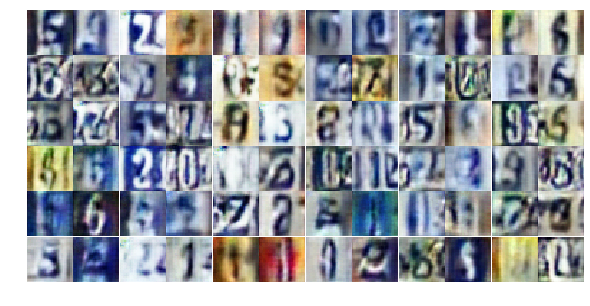

Epoch 13/100... Dloss: -1282.7134 Gloss: 3421.7148
Epoch 13/100... Dloss: -1979.1577 Gloss: 3685.8569
Epoch 13/100... Dloss: -3028.7354 Gloss: 4327.9248
Epoch 13/100... Dloss: -3157.4175 Gloss: 4392.7109
Epoch 13/100... Dloss: -3888.5200 Gloss: 5313.0596
Epoch 13/100... Dloss: 1372.2278 Gloss: 2208.9912
Epoch 13/100... Dloss: -2227.3591 Gloss: 3840.7737
Epoch 13/100... Dloss: -3134.5835 Gloss: 4785.6553
Epoch 13/100... Dloss: -1919.2733 Gloss: 3108.2234
Epoch 13/100... Dloss: -800.3782 Gloss: 2536.3591


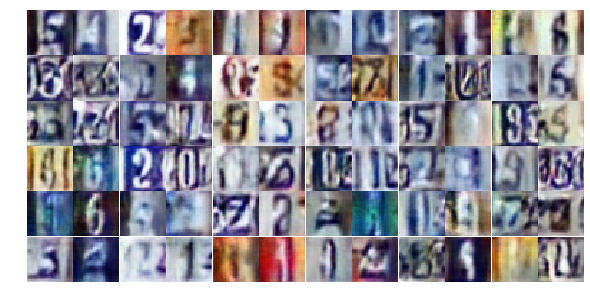

Epoch 13/100... Dloss: -3486.6479 Gloss: 4350.1123
Epoch 13/100... Dloss: -1127.2560 Gloss: 2159.9092
Epoch 13/100... Dloss: -3290.1777 Gloss: 4576.7622
(128, 100) (41, 32, 32, 3)
Epoch 14/100... Dloss: -1985.7557 Gloss: 4203.7373
Epoch 14/100... Dloss: -1764.0295 Gloss: 3050.1162
Epoch 14/100... Dloss: -2854.1816 Gloss: 3848.6438
Epoch 14/100... Dloss: -2077.9819 Gloss: 4083.7869
Epoch 14/100... Dloss: -1943.1783 Gloss: 3097.7236
Epoch 14/100... Dloss: -1771.6331 Gloss: 2843.2046
Epoch 14/100... Dloss: -1813.5417 Gloss: 7166.5850


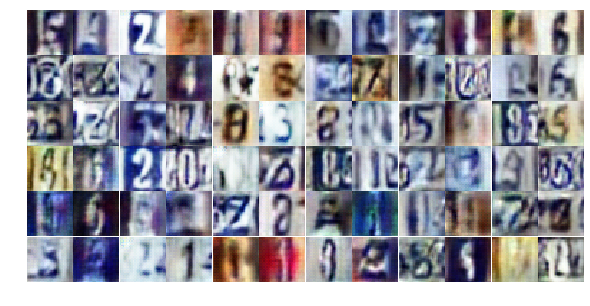

Epoch 14/100... Dloss: -2297.5723 Gloss: 3775.2891
Epoch 14/100... Dloss: -2904.5486 Gloss: 4323.3042
Epoch 14/100... Dloss: -3019.1816 Gloss: 4367.8945
Epoch 14/100... Dloss: -1699.9521 Gloss: 3390.0312
Epoch 14/100... Dloss: -2532.0957 Gloss: 4842.3506
Epoch 14/100... Dloss: -2197.3506 Gloss: 3538.6204
Epoch 14/100... Dloss: -1542.5627 Gloss: 3154.8269
Epoch 14/100... Dloss: -2912.3152 Gloss: 5152.4922
Epoch 14/100... Dloss: -2742.2405 Gloss: 4210.7764
Epoch 14/100... Dloss: -2216.6304 Gloss: 3711.8770


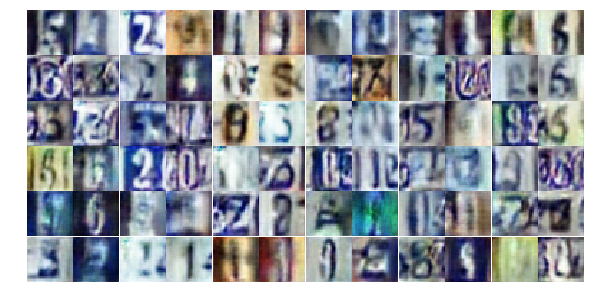

Epoch 14/100... Dloss: -3681.5789 Gloss: 5593.0903
Epoch 14/100... Dloss: -2129.8984 Gloss: 3156.3896
Epoch 14/100... Dloss: -3120.2622 Gloss: 4270.4136
Epoch 14/100... Dloss: -3057.9934 Gloss: 4099.1191
Epoch 14/100... Dloss: -5939.1309 Gloss: 6622.0273
Epoch 14/100... Dloss: 420.3039 Gloss: 88.8650
Epoch 14/100... Dloss: -4661.2031 Gloss: 6453.1621
Epoch 14/100... Dloss: -4785.4678 Gloss: 6450.0132
Epoch 14/100... Dloss: -1758.2943 Gloss: 2934.0283
Epoch 14/100... Dloss: -2736.5869 Gloss: 4673.2422


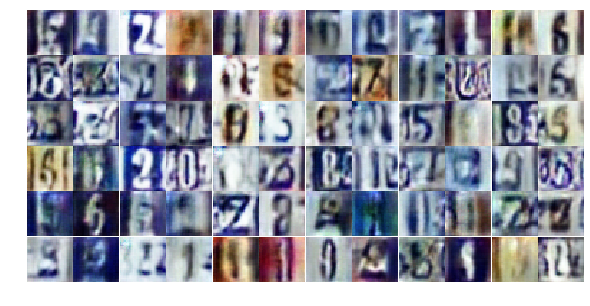

Epoch 14/100... Dloss: -3542.7852 Gloss: 4955.6196
Epoch 14/100... Dloss: -3042.6274 Gloss: 4449.1455
Epoch 14/100... Dloss: -4672.2153 Gloss: 8085.4209
Epoch 14/100... Dloss: -1787.5862 Gloss: 2977.1191
Epoch 14/100... Dloss: -5314.9980 Gloss: 7371.5127
Epoch 14/100... Dloss: -1777.3386 Gloss: 3181.2720
Epoch 14/100... Dloss: -2366.8616 Gloss: 3615.4731
Epoch 14/100... Dloss: -1864.0885 Gloss: 3566.8135
Epoch 14/100... Dloss: -2341.9004 Gloss: 4330.2349
Epoch 14/100... Dloss: -2966.9553 Gloss: 4489.0342


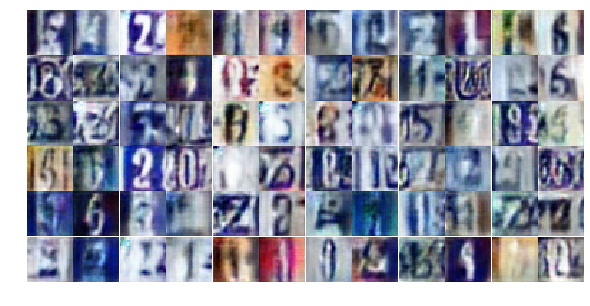

Epoch 14/100... Dloss: -3913.8750 Gloss: 5120.3564
Epoch 14/100... Dloss: -4196.4321 Gloss: 2749.8079
Epoch 14/100... Dloss: -2053.6284 Gloss: 3650.6721
Epoch 14/100... Dloss: -2067.6992 Gloss: 3604.6367
Epoch 14/100... Dloss: -2588.3145 Gloss: 4561.4819
Epoch 14/100... Dloss: -1609.8977 Gloss: 3366.7231
Epoch 14/100... Dloss: -3343.6960 Gloss: 4917.3984
Epoch 14/100... Dloss: -1847.8993 Gloss: 4238.7588
Epoch 14/100... Dloss: -1989.6279 Gloss: 3075.1431
Epoch 14/100... Dloss: -3747.4600 Gloss: 4320.4932


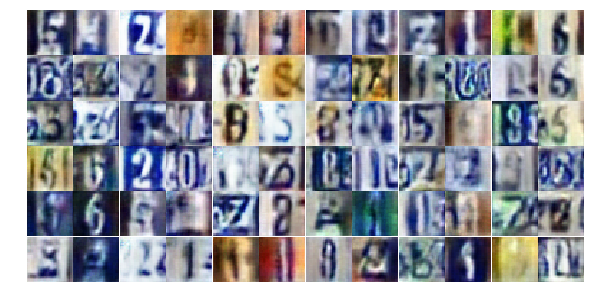

Epoch 14/100... Dloss: -2029.8140 Gloss: 3711.1196
Epoch 14/100... Dloss: -3708.9873 Gloss: 6423.3628
Epoch 14/100... Dloss: -1266.1193 Gloss: 3177.7954
Epoch 14/100... Dloss: -3734.0173 Gloss: 5491.9453
Epoch 14/100... Dloss: -1594.1244 Gloss: 3373.0715
Epoch 14/100... Dloss: -1603.3309 Gloss: 3488.0820
Epoch 14/100... Dloss: -6763.5049 Gloss: 7695.3306
Epoch 14/100... Dloss: -2987.7466 Gloss: 4853.8359
Epoch 14/100... Dloss: -843.0120 Gloss: 1801.4050
Epoch 14/100... Dloss: -1834.2252 Gloss: 3360.1089


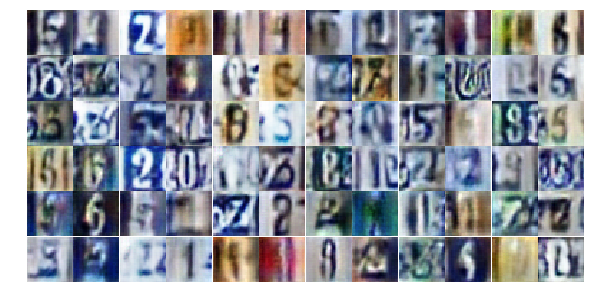

(128, 100) (41, 32, 32, 3)
Epoch 15/100... Dloss: -5004.3145 Gloss: 6258.3115
Epoch 15/100... Dloss: -3257.8394 Gloss: 4294.7339
Epoch 15/100... Dloss: -2996.2739 Gloss: 4546.1582
Epoch 15/100... Dloss: -2181.2734 Gloss: 3591.1719
Epoch 15/100... Dloss: -1852.9116 Gloss: 3899.8433
Epoch 15/100... Dloss: -3462.6924 Gloss: 5135.1787
Epoch 15/100... Dloss: -3026.7119 Gloss: 3887.4053
Epoch 15/100... Dloss: -2510.1948 Gloss: 4088.6763
Epoch 15/100... Dloss: -3072.1143 Gloss: 4725.6631
Epoch 15/100... Dloss: -2954.3550 Gloss: 4717.1074


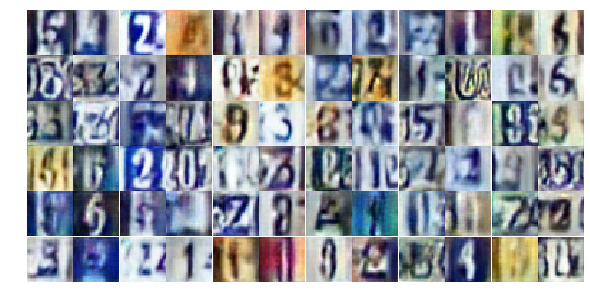

Epoch 15/100... Dloss: -2439.6819 Gloss: 4260.4531
Epoch 15/100... Dloss: -2907.3008 Gloss: 4178.3760
Epoch 15/100... Dloss: -3054.0142 Gloss: 4109.9868
Epoch 15/100... Dloss: -2877.4829 Gloss: 6050.0337
Epoch 15/100... Dloss: -1428.5642 Gloss: 3074.7764
Epoch 15/100... Dloss: -3038.7275 Gloss: 4427.4155
Epoch 15/100... Dloss: -4162.6309 Gloss: 5529.3760
Epoch 15/100... Dloss: -3025.3184 Gloss: 3916.6416
Epoch 15/100... Dloss: -4767.2524 Gloss: 6609.7349
Epoch 15/100... Dloss: -2380.6855 Gloss: 3520.8359


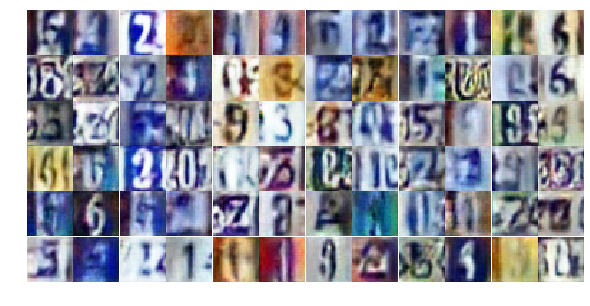

Epoch 15/100... Dloss: -2391.7075 Gloss: 4119.1680
Epoch 15/100... Dloss: -22.2142 Gloss: 883.7295
Epoch 15/100... Dloss: -1547.9513 Gloss: 2218.0928
Epoch 15/100... Dloss: -2363.1060 Gloss: 3315.4429
Epoch 15/100... Dloss: -1663.0259 Gloss: 4104.4082
Epoch 15/100... Dloss: -1791.7100 Gloss: 3907.4880
Epoch 15/100... Dloss: -3429.2473 Gloss: 4607.0039
Epoch 15/100... Dloss: -1573.8638 Gloss: 3545.6550
Epoch 15/100... Dloss: 216.9450 Gloss: 343.9537
Epoch 15/100... Dloss: -405.0710 Gloss: 545.1093


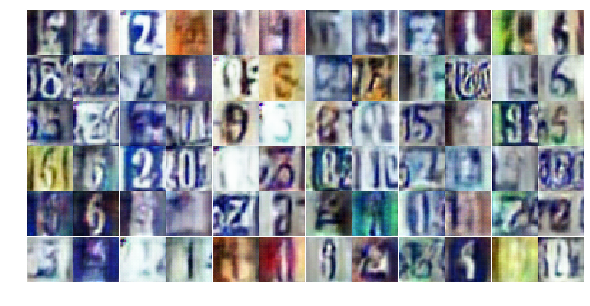

Epoch 15/100... Dloss: 124.3170 Gloss: 197.9432
Epoch 15/100... Dloss: -1283.0286 Gloss: 2912.6270
Epoch 15/100... Dloss: -1803.9175 Gloss: 2825.0803
Epoch 15/100... Dloss: -2522.2341 Gloss: 4277.5938
Epoch 15/100... Dloss: -1396.8916 Gloss: 3362.6279
Epoch 15/100... Dloss: -1959.0389 Gloss: 3693.4478
Epoch 15/100... Dloss: -3036.3025 Gloss: 5142.2197
Epoch 15/100... Dloss: -2689.9136 Gloss: 4013.6650
Epoch 15/100... Dloss: -536.7042 Gloss: 3513.5332
Epoch 15/100... Dloss: -2861.9971 Gloss: 4387.3926


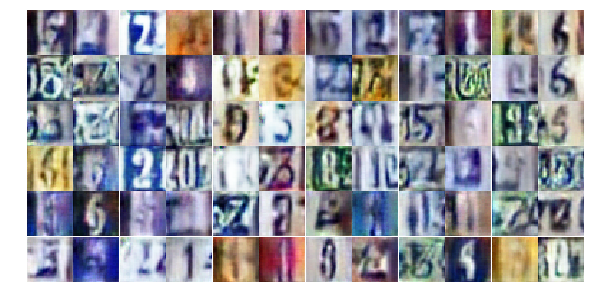

Epoch 15/100... Dloss: -2366.0679 Gloss: 4139.9521
Epoch 15/100... Dloss: -1733.6125 Gloss: 3568.7397
Epoch 15/100... Dloss: -4029.2871 Gloss: 6343.5952
Epoch 15/100... Dloss: -3513.8872 Gloss: 2620.8794
Epoch 15/100... Dloss: -295.8164 Gloss: 1026.1538
Epoch 15/100... Dloss: -3053.4194 Gloss: 5279.9175
Epoch 15/100... Dloss: -2364.8914 Gloss: 3887.8535
Epoch 15/100... Dloss: -3420.4041 Gloss: 4542.8965
Epoch 15/100... Dloss: -3416.9761 Gloss: 4971.6484
Epoch 15/100... Dloss: -1632.4994 Gloss: 3000.7021


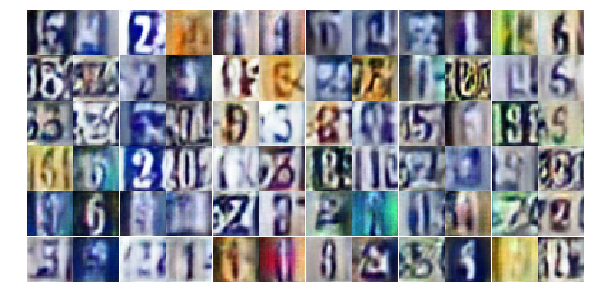

Epoch 15/100... Dloss: 300.1941 Gloss: 1318.9178
Epoch 15/100... Dloss: -5416.5625 Gloss: 6954.3774
Epoch 15/100... Dloss: -908.9163 Gloss: 1798.6588
Epoch 15/100... Dloss: -1598.1678 Gloss: 3868.3677
Epoch 15/100... Dloss: -2714.1323 Gloss: 5312.9307
Epoch 15/100... Dloss: 307.6034 Gloss: 564.5450
Epoch 15/100... Dloss: -244.6386 Gloss: 1868.8712
Epoch 15/100... Dloss: -131.2065 Gloss: 1691.7916
(128, 100) (41, 32, 32, 3)
Epoch 16/100... Dloss: -222.4203 Gloss: 557.1512
Epoch 16/100... Dloss: -651.4838 Gloss: 1121.6750


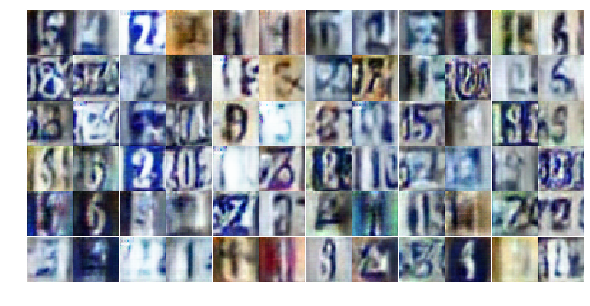

Epoch 16/100... Dloss: -386.3138 Gloss: 2670.0403
Epoch 16/100... Dloss: 230.7483 Gloss: 393.5879
Epoch 16/100... Dloss: -693.7805 Gloss: 912.3862
Epoch 16/100... Dloss: 166.5777 Gloss: 1046.9360
Epoch 16/100... Dloss: -2647.8154 Gloss: 3919.0215
Epoch 16/100... Dloss: -3217.3359 Gloss: 4929.6123
Epoch 16/100... Dloss: 194.9971 Gloss: 1043.6123
Epoch 16/100... Dloss: -2028.2649 Gloss: 3659.7505
Epoch 16/100... Dloss: -1571.9075 Gloss: 2436.9858
Epoch 16/100... Dloss: -701.4260 Gloss: 2384.5598


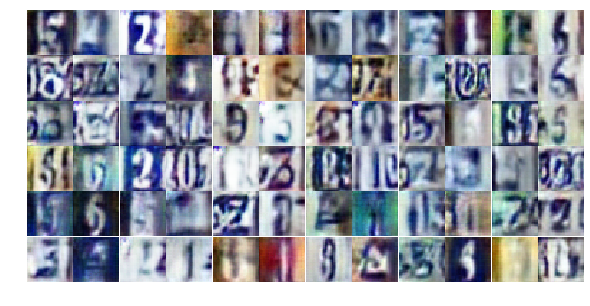

Epoch 16/100... Dloss: -2976.4409 Gloss: 4701.4365
Epoch 16/100... Dloss: -3701.4045 Gloss: 6616.9111
Epoch 16/100... Dloss: 688.1179 Gloss: 2640.7437
Epoch 16/100... Dloss: -5229.4824 Gloss: 6075.4077
Epoch 16/100... Dloss: -1864.5334 Gloss: 3798.6677
Epoch 16/100... Dloss: 1017.6859 Gloss: 819.0008
Epoch 16/100... Dloss: -4165.0605 Gloss: 5094.3994
Epoch 16/100... Dloss: -1703.3347 Gloss: 3559.0378
Epoch 16/100... Dloss: -2331.3477 Gloss: 4133.0713
Epoch 16/100... Dloss: -3224.3013 Gloss: 6685.8418


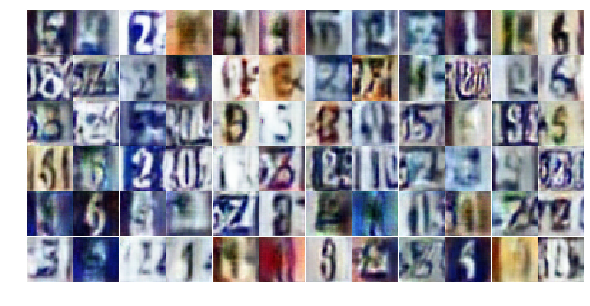

Epoch 16/100... Dloss: -2591.6790 Gloss: 4980.5850
Epoch 16/100... Dloss: -4509.6909 Gloss: 5964.4775
Epoch 16/100... Dloss: -3182.4028 Gloss: 4656.8164
Epoch 16/100... Dloss: -1380.7327 Gloss: 5243.4810
Epoch 16/100... Dloss: -2240.3503 Gloss: 3779.5315
Epoch 16/100... Dloss: -2455.2830 Gloss: 3591.3501
Epoch 16/100... Dloss: -2027.9392 Gloss: 4275.7803
Epoch 16/100... Dloss: -2503.2202 Gloss: 4212.4927
Epoch 16/100... Dloss: -3460.4478 Gloss: 6592.7656
Epoch 16/100... Dloss: -959.4652 Gloss: 2813.9839


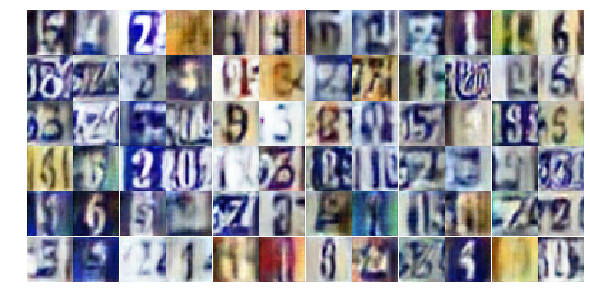

Epoch 16/100... Dloss: -3672.7827 Gloss: 5187.6260
Epoch 16/100... Dloss: -1336.9926 Gloss: 2954.8872
Epoch 16/100... Dloss: -1295.0854 Gloss: 3846.0176
Epoch 16/100... Dloss: -4073.5991 Gloss: 5198.0869
Epoch 16/100... Dloss: -1477.9237 Gloss: 3302.7627
Epoch 16/100... Dloss: -41.5796 Gloss: 417.7169
Epoch 16/100... Dloss: -2032.1243 Gloss: 4692.4561
Epoch 16/100... Dloss: -1720.6221 Gloss: 3609.4832
Epoch 16/100... Dloss: -2405.4976 Gloss: 4759.6050
Epoch 16/100... Dloss: -3597.0886 Gloss: 3325.3506


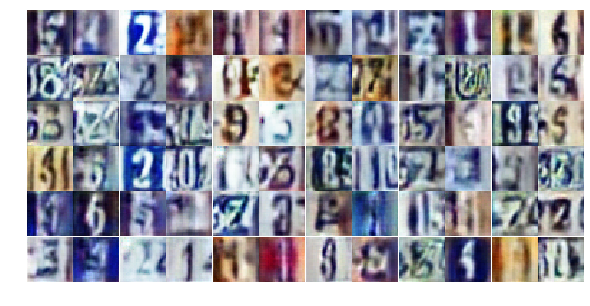

Epoch 16/100... Dloss: -1853.0812 Gloss: 5261.9106
Epoch 16/100... Dloss: -124.6796 Gloss: 1091.4958
Epoch 16/100... Dloss: -2205.5115 Gloss: 3221.8711
Epoch 16/100... Dloss: -1004.9877 Gloss: 2424.9424
Epoch 16/100... Dloss: -4513.1880 Gloss: 5927.5762
Epoch 16/100... Dloss: -5294.0693 Gloss: 6703.0107
Epoch 16/100... Dloss: -1766.3639 Gloss: 2665.8130
Epoch 16/100... Dloss: -2119.6960 Gloss: 3345.8896
Epoch 16/100... Dloss: -2708.4163 Gloss: 4531.6431
Epoch 16/100... Dloss: -2584.4683 Gloss: 4808.4902


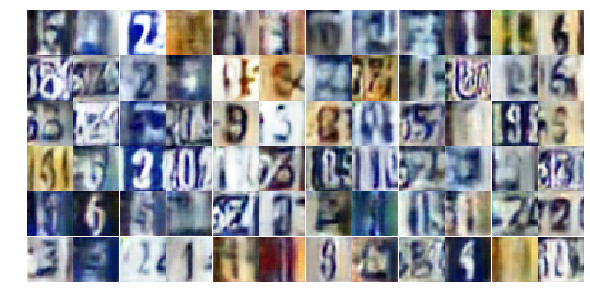

Epoch 16/100... Dloss: -2172.7070 Gloss: 4386.1074
Epoch 16/100... Dloss: -1546.8315 Gloss: 3520.1777
Epoch 16/100... Dloss: -3302.2334 Gloss: 4918.2793
Epoch 16/100... Dloss: -5455.0381 Gloss: 8092.4121
Epoch 16/100... Dloss: -1832.1405 Gloss: 3725.8813
(128, 100) (41, 32, 32, 3)
Epoch 17/100... Dloss: -2191.5610 Gloss: 5267.5430
Epoch 17/100... Dloss: -3912.8418 Gloss: 5027.1606
Epoch 17/100... Dloss: -2890.8379 Gloss: 5323.6221
Epoch 17/100... Dloss: -2331.8718 Gloss: 4331.4897
Epoch 17/100... Dloss: -5536.7397 Gloss: 8133.0215


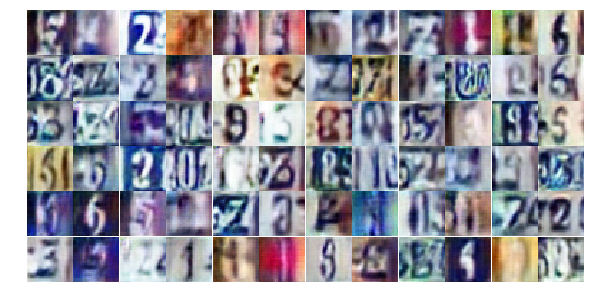

Epoch 17/100... Dloss: -5147.3877 Gloss: 5841.0005
Epoch 17/100... Dloss: -2576.9814 Gloss: 3892.4365
Epoch 17/100... Dloss: -3020.3606 Gloss: 5017.8086
Epoch 17/100... Dloss: -1705.7451 Gloss: 3408.3982
Epoch 17/100... Dloss: -3814.0479 Gloss: 5981.4165
Epoch 17/100... Dloss: -2433.7178 Gloss: 4104.6084
Epoch 17/100... Dloss: -1951.9360 Gloss: 4301.4072
Epoch 17/100... Dloss: -2542.9766 Gloss: 4167.3389
Epoch 17/100... Dloss: -557.8434 Gloss: 3610.9468
Epoch 17/100... Dloss: -1751.8477 Gloss: 3372.2778


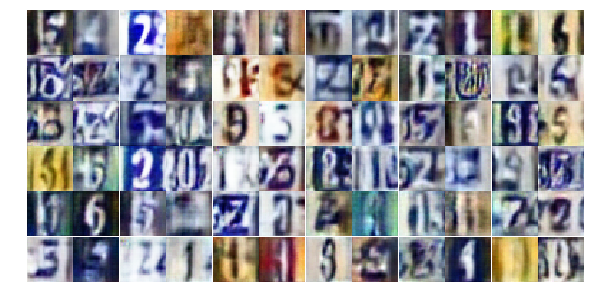

Epoch 17/100... Dloss: -2947.6660 Gloss: 4540.4375
Epoch 17/100... Dloss: -2331.6382 Gloss: 4503.6621
Epoch 17/100... Dloss: -2891.8882 Gloss: 4182.6094
Epoch 17/100... Dloss: -1137.2792 Gloss: 1238.7092
Epoch 17/100... Dloss: 455.5552 Gloss: 1400.2922
Epoch 17/100... Dloss: -2523.1982 Gloss: 4098.9209
Epoch 17/100... Dloss: -1360.3071 Gloss: 2717.5127
Epoch 17/100... Dloss: -1175.1816 Gloss: 2393.5549
Epoch 17/100... Dloss: -3394.8335 Gloss: 5726.0586
Epoch 17/100... Dloss: -2756.6182 Gloss: 4179.9795


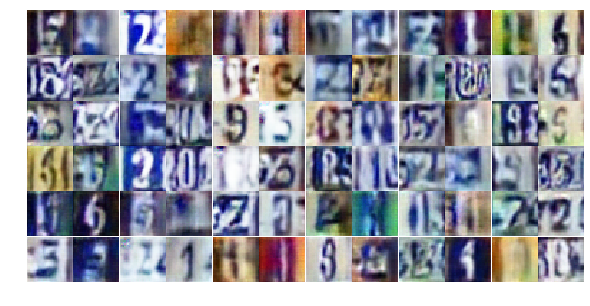

Epoch 17/100... Dloss: -3312.6240 Gloss: 5623.9014
Epoch 17/100... Dloss: -4127.6191 Gloss: 6416.5327
Epoch 17/100... Dloss: -2082.1245 Gloss: 4199.7822
Epoch 17/100... Dloss: -2521.9585 Gloss: 4071.9980
Epoch 17/100... Dloss: -3047.5488 Gloss: 4537.6182
Epoch 17/100... Dloss: -2926.5847 Gloss: 5716.3994
Epoch 17/100... Dloss: -2691.6743 Gloss: 4352.9238
Epoch 17/100... Dloss: -1788.0718 Gloss: 6980.3662
Epoch 17/100... Dloss: -3771.9170 Gloss: 7345.3320
Epoch 17/100... Dloss: -269.4490 Gloss: 8168.7822


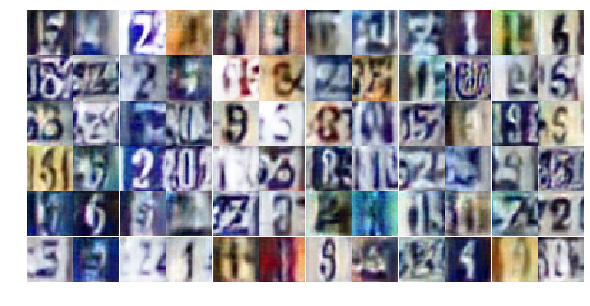

Epoch 17/100... Dloss: -272.4445 Gloss: 1710.7744
Epoch 17/100... Dloss: -3095.6611 Gloss: 4692.5713
Epoch 17/100... Dloss: -2397.2664 Gloss: 4146.9189
Epoch 17/100... Dloss: -2724.5325 Gloss: 4534.9014
Epoch 17/100... Dloss: -2801.9980 Gloss: 4622.7764
Epoch 17/100... Dloss: -3926.4143 Gloss: 6185.2603
Epoch 17/100... Dloss: -5981.8174 Gloss: 7537.0215
Epoch 17/100... Dloss: -3902.2559 Gloss: 6276.1807
Epoch 17/100... Dloss: -1892.2063 Gloss: 4674.7754
Epoch 17/100... Dloss: -4006.1450 Gloss: 6854.5713


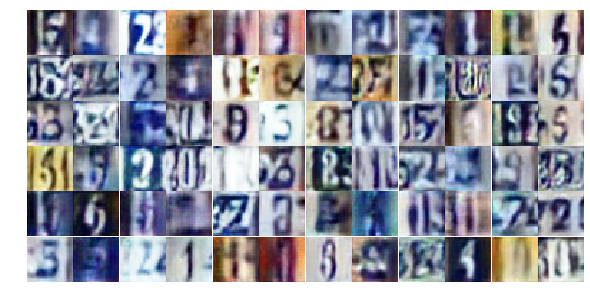

Epoch 17/100... Dloss: -704.8286 Gloss: 2558.8384
Epoch 17/100... Dloss: -1389.4413 Gloss: 4067.5117
Epoch 17/100... Dloss: -2044.7476 Gloss: 3397.2373
Epoch 17/100... Dloss: -2246.5713 Gloss: 3591.4175
Epoch 17/100... Dloss: -3321.0449 Gloss: 7184.6904
Epoch 17/100... Dloss: -5042.1436 Gloss: 7190.7061
Epoch 17/100... Dloss: -2705.7607 Gloss: 4042.7065
Epoch 17/100... Dloss: -4959.1016 Gloss: 5571.6025
Epoch 17/100... Dloss: -778.1223 Gloss: 1193.1825
Epoch 17/100... Dloss: -3271.4382 Gloss: 5290.6211


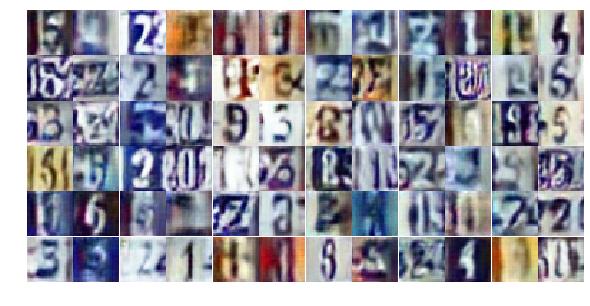

Epoch 17/100... Dloss: 444.6299 Gloss: 1544.5525
Epoch 17/100... Dloss: -4120.7344 Gloss: 7595.8569
(128, 100) (41, 32, 32, 3)
Epoch 18/100... Dloss: -673.7344 Gloss: 3084.7837
Epoch 18/100... Dloss: -1077.7257 Gloss: 3177.5723
Epoch 18/100... Dloss: -4623.4175 Gloss: 6937.1934
Epoch 18/100... Dloss: -2363.3687 Gloss: 4237.1523
Epoch 18/100... Dloss: -3072.3496 Gloss: 4582.5264
Epoch 18/100... Dloss: -5658.6924 Gloss: 4939.6348
Epoch 18/100... Dloss: -677.9657 Gloss: 2149.1379
Epoch 18/100... Dloss: -800.5717 Gloss: 2380.6357


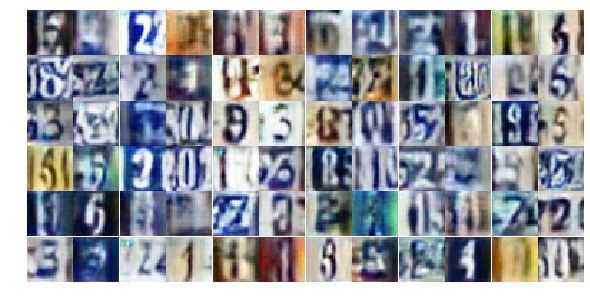

Epoch 18/100... Dloss: -468.7128 Gloss: 2400.6685
Epoch 18/100... Dloss: -556.1624 Gloss: 3092.4624
Epoch 18/100... Dloss: -2364.5671 Gloss: 4150.2798
Epoch 18/100... Dloss: -5175.0454 Gloss: 7376.2734
Epoch 18/100... Dloss: -1296.8009 Gloss: 2937.5127
Epoch 18/100... Dloss: -1546.6160 Gloss: 3772.1143
Epoch 18/100... Dloss: -2486.3550 Gloss: 5536.1953
Epoch 18/100... Dloss: -5141.6860 Gloss: 7521.6367
Epoch 18/100... Dloss: -3386.9497 Gloss: 4787.0928
Epoch 18/100... Dloss: -1608.4485 Gloss: 3912.2451


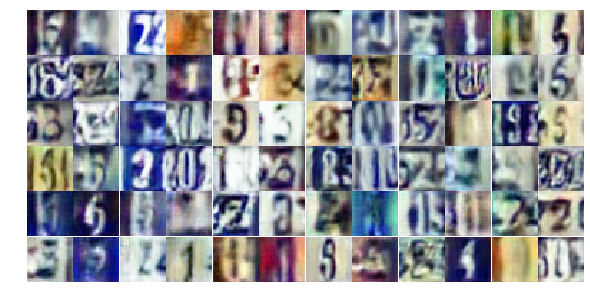

Epoch 18/100... Dloss: -2210.3672 Gloss: 5624.5586
Epoch 18/100... Dloss: -109.5640 Gloss: 1950.8318
Epoch 18/100... Dloss: -2659.7966 Gloss: 5027.2979
Epoch 18/100... Dloss: -1409.5371 Gloss: 5782.2305
Epoch 18/100... Dloss: -2689.5911 Gloss: 4568.8096
Epoch 18/100... Dloss: -2846.6921 Gloss: 4188.6025
Epoch 18/100... Dloss: -1700.8914 Gloss: 3423.5859
Epoch 18/100... Dloss: -5824.0073 Gloss: 7516.8618
Epoch 18/100... Dloss: -1897.9597 Gloss: 5538.2646
Epoch 18/100... Dloss: -3816.8501 Gloss: 5547.9888


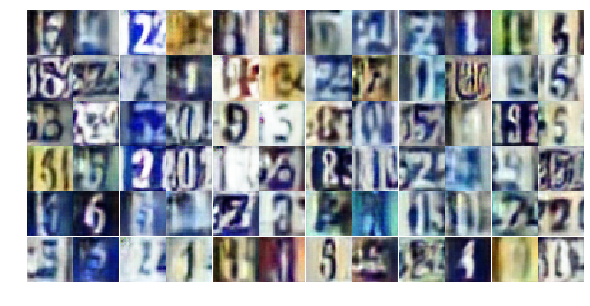

Epoch 18/100... Dloss: -1798.5344 Gloss: 4418.6406
Epoch 18/100... Dloss: -2532.7942 Gloss: 4729.4355
Epoch 18/100... Dloss: -8405.1240 Gloss: 12328.8672
Epoch 18/100... Dloss: -5461.6523 Gloss: 8546.0967
Epoch 18/100... Dloss: -4530.7305 Gloss: 6742.6704
Epoch 18/100... Dloss: -2380.0044 Gloss: 4062.2651
Epoch 18/100... Dloss: 242.3353 Gloss: 2054.8550
Epoch 18/100... Dloss: -3933.2761 Gloss: 5892.1748
Epoch 18/100... Dloss: -2324.6809 Gloss: 5475.9600
Epoch 18/100... Dloss: -251.0824 Gloss: 2880.0371


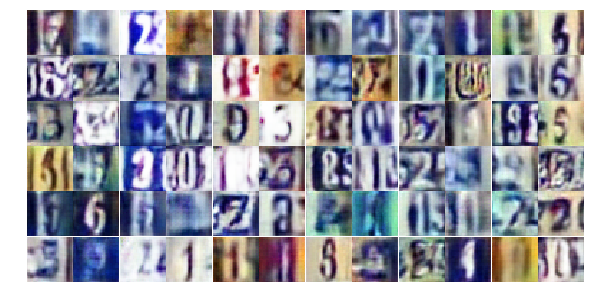

Epoch 18/100... Dloss: -1840.1567 Gloss: 4295.0459
Epoch 18/100... Dloss: -4795.1997 Gloss: 7028.3296
Epoch 18/100... Dloss: -2404.4507 Gloss: 4513.9189
Epoch 18/100... Dloss: -1175.5638 Gloss: 1638.5355
Epoch 18/100... Dloss: -762.5048 Gloss: 1282.3191
Epoch 18/100... Dloss: -5689.0654 Gloss: 6479.8066
Epoch 18/100... Dloss: -5088.3081 Gloss: 5758.4692
Epoch 18/100... Dloss: -2960.3181 Gloss: 4787.3071
Epoch 18/100... Dloss: -5672.3330 Gloss: 8338.0361
Epoch 18/100... Dloss: -1734.3915 Gloss: 1761.3707


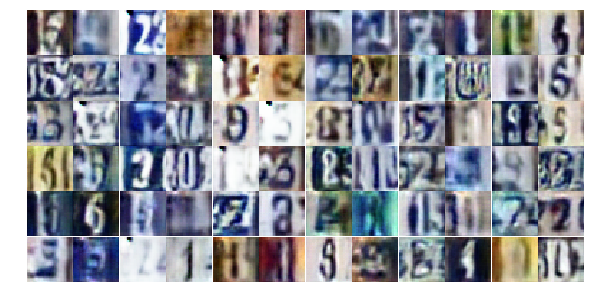

Epoch 18/100... Dloss: -4959.5039 Gloss: 6999.8350
Epoch 18/100... Dloss: -3475.7612 Gloss: 5475.8711
Epoch 18/100... Dloss: -3681.6138 Gloss: 5150.7065
Epoch 18/100... Dloss: -2930.0737 Gloss: 5664.7422
Epoch 18/100... Dloss: -3035.5137 Gloss: 5360.5801
Epoch 18/100... Dloss: 551.5171 Gloss: 1485.9385
Epoch 18/100... Dloss: -466.0322 Gloss: 580.3520
Epoch 18/100... Dloss: -1616.0239 Gloss: 3644.6179
Epoch 18/100... Dloss: -2330.3098 Gloss: 4298.4214
(128, 100) (41, 32, 32, 3)
Epoch 19/100... Dloss: -5384.1689 Gloss: 9447.7373


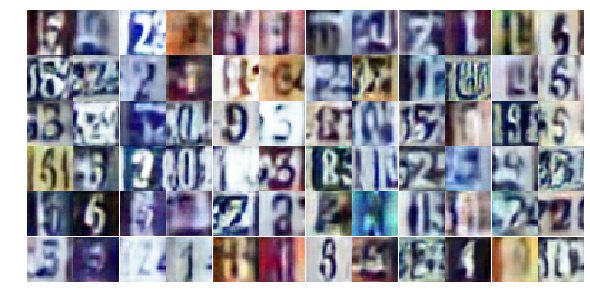

Epoch 19/100... Dloss: -2005.6497 Gloss: 6189.0234
Epoch 19/100... Dloss: 2543.3354 Gloss: -823.1816
Epoch 19/100... Dloss: 52.2254 Gloss: 152.6828
Epoch 19/100... Dloss: -285.5852 Gloss: 1343.8242
Epoch 19/100... Dloss: -96.5791 Gloss: 406.0455
Epoch 19/100... Dloss: -299.6843 Gloss: 1143.4812
Epoch 19/100... Dloss: -3591.2471 Gloss: 5859.1318
Epoch 19/100... Dloss: -1923.7527 Gloss: 4554.2256
Epoch 19/100... Dloss: -4770.3340 Gloss: 6246.7607
Epoch 19/100... Dloss: -113.5077 Gloss: 1518.0881


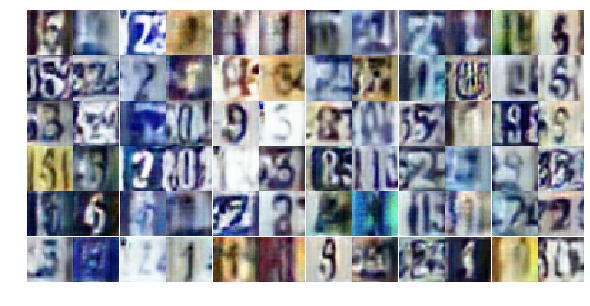

Epoch 19/100... Dloss: -3765.6802 Gloss: 7043.6782
Epoch 19/100... Dloss: -1196.1398 Gloss: 1655.1783
Epoch 19/100... Dloss: -1454.7009 Gloss: 2534.5186
Epoch 19/100... Dloss: -72.5811 Gloss: 1108.8865
Epoch 19/100... Dloss: -6647.7236 Gloss: 8392.4766
Epoch 19/100... Dloss: -289.5036 Gloss: 1384.3916
Epoch 19/100... Dloss: -837.8952 Gloss: 1751.0205
Epoch 19/100... Dloss: -1648.0616 Gloss: 3473.8650
Epoch 19/100... Dloss: -9868.5576 Gloss: 12321.6582
Epoch 19/100... Dloss: -324.4847 Gloss: 438.7387


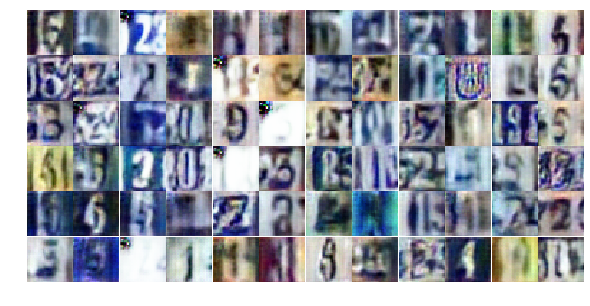

Epoch 19/100... Dloss: 408.3485 Gloss: -234.3381
Epoch 19/100... Dloss: -1300.3774 Gloss: 1771.9882
Epoch 19/100... Dloss: -3869.1724 Gloss: 6459.4707
Epoch 19/100... Dloss: -416.9662 Gloss: 1355.0977
Epoch 19/100... Dloss: -3825.3943 Gloss: 5112.9141
Epoch 19/100... Dloss: -26.8818 Gloss: 1447.6978
Epoch 19/100... Dloss: -5632.7661 Gloss: 7512.5825
Epoch 19/100... Dloss: -2976.2288 Gloss: 6855.2295
Epoch 19/100... Dloss: -376.5669 Gloss: 4643.1055
Epoch 19/100... Dloss: -2940.9556 Gloss: 4642.7969


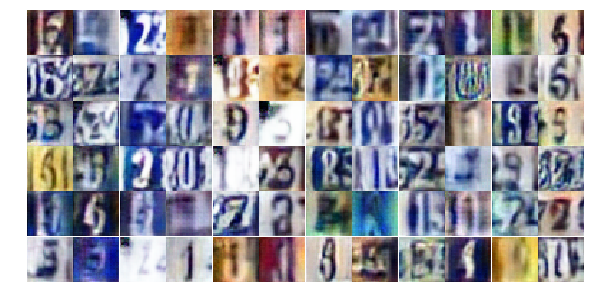

Epoch 19/100... Dloss: -1141.5110 Gloss: 1078.6958
Epoch 19/100... Dloss: -1831.7563 Gloss: 3066.7334
Epoch 19/100... Dloss: -5102.5898 Gloss: 5532.0166
Epoch 19/100... Dloss: -2637.9832 Gloss: 8007.3467
Epoch 19/100... Dloss: -1523.0875 Gloss: 2431.0176
Epoch 19/100... Dloss: -3289.6355 Gloss: 5386.1924
Epoch 19/100... Dloss: -846.6165 Gloss: 1769.9890
Epoch 19/100... Dloss: -2712.1113 Gloss: 4871.9370
Epoch 19/100... Dloss: -2601.4993 Gloss: 4610.5674
Epoch 19/100... Dloss: -4371.3896 Gloss: 5817.1040


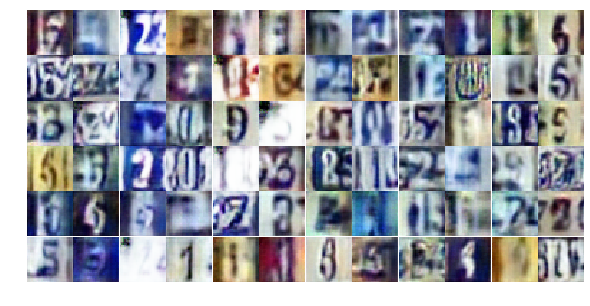

Epoch 19/100... Dloss: -2872.8525 Gloss: 4986.7188
Epoch 19/100... Dloss: -1596.6263 Gloss: 4399.5645
Epoch 19/100... Dloss: -5879.0146 Gloss: 8260.6709
Epoch 19/100... Dloss: -4988.0190 Gloss: 4744.0801
Epoch 19/100... Dloss: -469.1601 Gloss: 695.0991
Epoch 19/100... Dloss: 470.9570 Gloss: -181.3295
Epoch 19/100... Dloss: -488.1440 Gloss: 1006.1956
Epoch 19/100... Dloss: -5415.1440 Gloss: 3699.0781
Epoch 19/100... Dloss: -1328.7853 Gloss: 2339.7322
Epoch 19/100... Dloss: 709.2074 Gloss: 531.9399


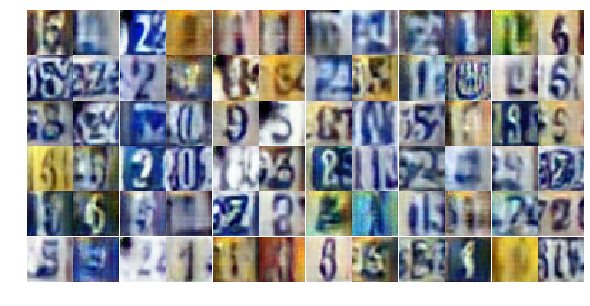

Epoch 19/100... Dloss: -3344.1040 Gloss: 5150.8940
Epoch 19/100... Dloss: -4757.9229 Gloss: 5326.0586
Epoch 19/100... Dloss: -6233.5654 Gloss: 8609.6914
Epoch 19/100... Dloss: -3512.4343 Gloss: 5748.4424
Epoch 19/100... Dloss: -3237.8735 Gloss: 6023.2085
Epoch 19/100... Dloss: -3260.4646 Gloss: 4717.7275
(128, 100) (41, 32, 32, 3)
Epoch 20/100... Dloss: -8646.6934 Gloss: 11896.5234
Epoch 20/100... Dloss: -1357.5198 Gloss: 4148.2666
Epoch 20/100... Dloss: -3768.5110 Gloss: 6870.2974
Epoch 20/100... Dloss: -1609.4253 Gloss: 7710.7266


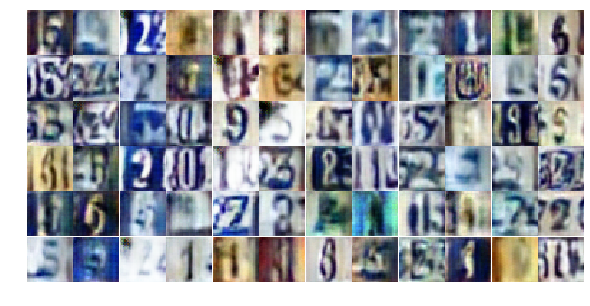

Epoch 20/100... Dloss: -2860.2422 Gloss: 4447.7290
Epoch 20/100... Dloss: -2996.0059 Gloss: 6342.8555
Epoch 20/100... Dloss: -1459.7961 Gloss: 3811.7148
Epoch 20/100... Dloss: -3055.2219 Gloss: 4781.2588
Epoch 20/100... Dloss: -1910.9446 Gloss: 3492.2178
Epoch 20/100... Dloss: 1117.2839 Gloss: 1667.8127
Epoch 20/100... Dloss: -1813.2655 Gloss: 3830.0203
Epoch 20/100... Dloss: -1734.0664 Gloss: 3776.1863
Epoch 20/100... Dloss: -5870.4224 Gloss: 9742.1611
Epoch 20/100... Dloss: -2019.2642 Gloss: 3829.3818


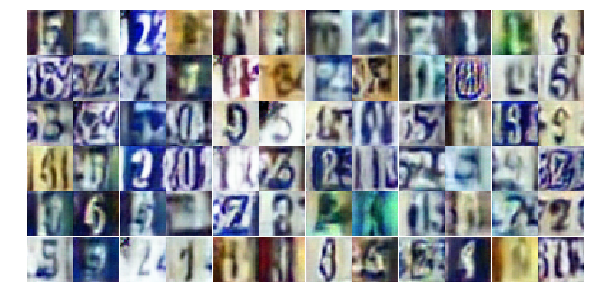

Epoch 20/100... Dloss: -2632.1174 Gloss: 5035.0176
Epoch 20/100... Dloss: -2950.8931 Gloss: 5442.6836
Epoch 20/100... Dloss: -4575.8237 Gloss: 8351.2402
Epoch 20/100... Dloss: -2992.3628 Gloss: 5080.8296
Epoch 20/100... Dloss: -2682.6023 Gloss: 4717.6528
Epoch 20/100... Dloss: -7052.2490 Gloss: 10832.0059
Epoch 20/100... Dloss: -2326.9644 Gloss: 6877.5044
Epoch 20/100... Dloss: -8276.7334 Gloss: 9934.4453
Epoch 20/100... Dloss: -4217.1069 Gloss: 7019.8145
Epoch 20/100... Dloss: -2883.5259 Gloss: 5092.8218


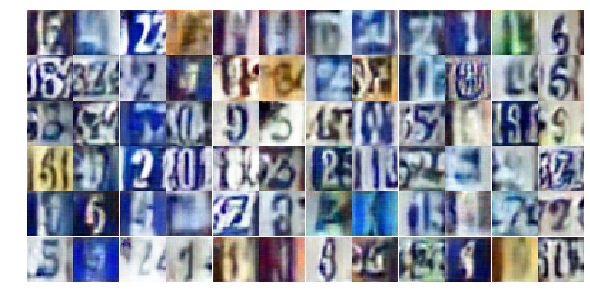

Epoch 20/100... Dloss: -45.4485 Gloss: 1281.4854
Epoch 20/100... Dloss: -2816.5737 Gloss: 6652.1113
Epoch 20/100... Dloss: -6829.2119 Gloss: 6705.9146
Epoch 20/100... Dloss: 4061.3262 Gloss: -478.8018
Epoch 20/100... Dloss: -1127.4783 Gloss: 1605.1926
Epoch 20/100... Dloss: -1557.8497 Gloss: 2426.1616
Epoch 20/100... Dloss: -1401.6865 Gloss: 3203.2407
Epoch 20/100... Dloss: -3116.2756 Gloss: 5418.6284
Epoch 20/100... Dloss: -2150.7114 Gloss: 4776.9980
Epoch 20/100... Dloss: -10567.6816 Gloss: 12339.5801


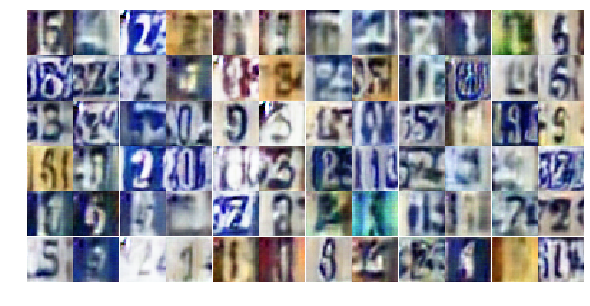

Epoch 20/100... Dloss: -2480.6592 Gloss: 4613.8369
Epoch 20/100... Dloss: -3110.1538 Gloss: 4971.5234
Epoch 20/100... Dloss: -3442.1672 Gloss: 5560.7812
Epoch 20/100... Dloss: -1137.5518 Gloss: 2410.0874
Epoch 20/100... Dloss: 115.7052 Gloss: 3136.0332
Epoch 20/100... Dloss: -4924.0635 Gloss: 9056.3965
Epoch 20/100... Dloss: -2754.4321 Gloss: 4699.4673
Epoch 20/100... Dloss: -3122.4172 Gloss: 7296.4800
Epoch 20/100... Dloss: -6109.7021 Gloss: 7766.4585
Epoch 20/100... Dloss: -6414.2031 Gloss: 8281.6211


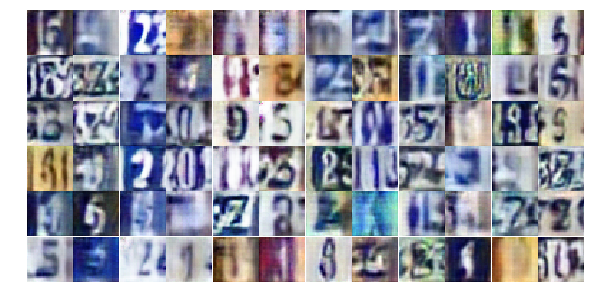

Epoch 20/100... Dloss: -7500.1191 Gloss: 3139.6123
Epoch 20/100... Dloss: -168.2853 Gloss: 3242.9438
Epoch 20/100... Dloss: -1933.6042 Gloss: 3588.0273
Epoch 20/100... Dloss: -3572.1040 Gloss: 5320.2539
Epoch 20/100... Dloss: -1376.3826 Gloss: 4922.1416
Epoch 20/100... Dloss: 3140.1711 Gloss: 767.7562
Epoch 20/100... Dloss: -2175.4136 Gloss: 4588.8398
Epoch 20/100... Dloss: -2316.1179 Gloss: 4547.3936
Epoch 20/100... Dloss: -1669.4979 Gloss: 2876.4351
Epoch 20/100... Dloss: -3028.8857 Gloss: 5403.7373


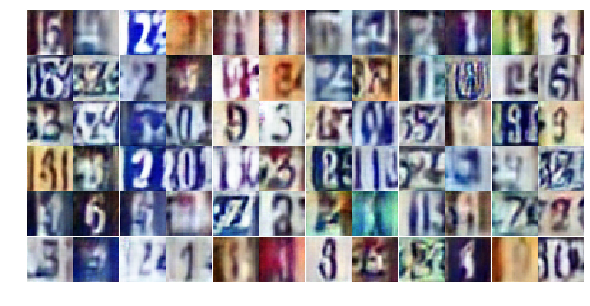

Epoch 20/100... Dloss: -5272.2383 Gloss: 7750.9404
Epoch 20/100... Dloss: -1319.2474 Gloss: 3334.4399
Epoch 20/100... Dloss: -4923.6543 Gloss: 9774.8936
Epoch 20/100... Dloss: -6240.1777 Gloss: 7330.2168
(128, 100) (41, 32, 32, 3)
Epoch 21/100... Dloss: -344.0460 Gloss: 629.2842
Epoch 21/100... Dloss: -535.2983 Gloss: 2113.5017
Epoch 21/100... Dloss: -388.3599 Gloss: 4329.4580
Epoch 21/100... Dloss: -3667.3772 Gloss: 8135.2681
Epoch 21/100... Dloss: -2301.0566 Gloss: 7793.7119
Epoch 21/100... Dloss: -5568.7466 Gloss: 9218.5742


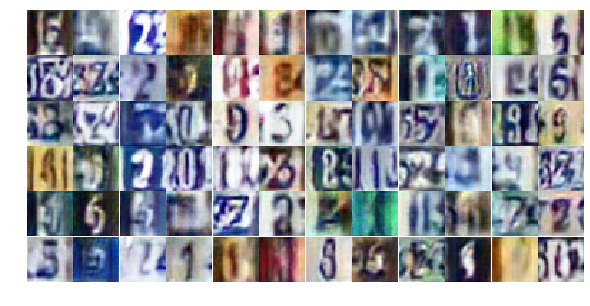

Epoch 21/100... Dloss: -1742.4315 Gloss: 3015.4285
Epoch 21/100... Dloss: -2566.8442 Gloss: 4716.7144
Epoch 21/100... Dloss: -627.1566 Gloss: 2768.3599
Epoch 21/100... Dloss: -2043.3127 Gloss: 3636.2183
Epoch 21/100... Dloss: -3081.8645 Gloss: 6076.9600
Epoch 21/100... Dloss: -3149.9863 Gloss: 6889.5928
Epoch 21/100... Dloss: -3844.1406 Gloss: 6092.0947
Epoch 21/100... Dloss: -4358.3301 Gloss: 8145.7930
Epoch 21/100... Dloss: -5019.0562 Gloss: 8674.5869
Epoch 21/100... Dloss: 189.7344 Gloss: 8550.6035


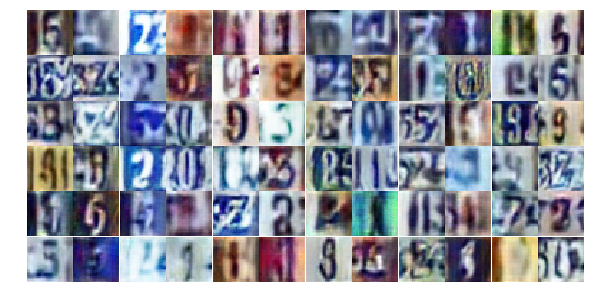

Epoch 21/100... Dloss: -3685.0496 Gloss: 8013.2085
Epoch 21/100... Dloss: 2978.7966 Gloss: 1803.1133
Epoch 21/100... Dloss: -3694.7012 Gloss: 5897.1338
Epoch 21/100... Dloss: 533.9464 Gloss: 324.0822
Epoch 21/100... Dloss: -3558.3403 Gloss: 5165.3774
Epoch 21/100... Dloss: -2832.9558 Gloss: 6545.5977
Epoch 21/100... Dloss: -2054.9658 Gloss: 5920.3936
Epoch 21/100... Dloss: -3282.8022 Gloss: 8127.7539
Epoch 21/100... Dloss: -1839.6846 Gloss: 3571.3027
Epoch 21/100... Dloss: -6928.2305 Gloss: 11926.9766


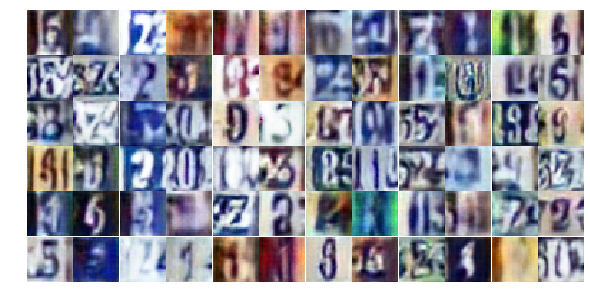

Epoch 21/100... Dloss: 2150.1414 Gloss: 229.6186
Epoch 21/100... Dloss: -496.7016 Gloss: 1223.2480
Epoch 21/100... Dloss: -3026.3071 Gloss: 4681.2407
Epoch 21/100... Dloss: -1507.4608 Gloss: 4497.5386
Epoch 21/100... Dloss: -2895.1785 Gloss: 5999.2114
Epoch 21/100... Dloss: 1532.2305 Gloss: 838.7281
Epoch 21/100... Dloss: -5566.3213 Gloss: 11106.9336
Epoch 21/100... Dloss: -3966.2983 Gloss: 7055.4072
Epoch 21/100... Dloss: -4778.9346 Gloss: 7498.6377
Epoch 21/100... Dloss: -920.8939 Gloss: 2502.5552


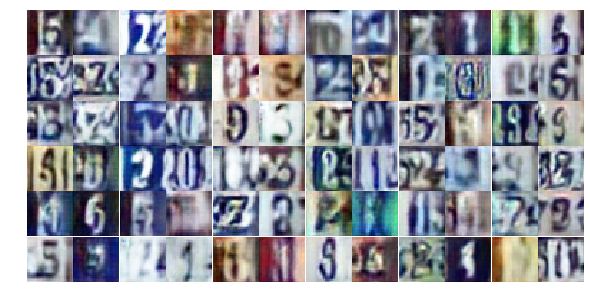

Epoch 21/100... Dloss: -2749.9585 Gloss: 5387.1191
Epoch 21/100... Dloss: -3717.0415 Gloss: 6738.5479
Epoch 21/100... Dloss: -5657.4570 Gloss: 8524.1074
Epoch 21/100... Dloss: 1312.1833 Gloss: 8298.8516
Epoch 21/100... Dloss: -3500.0923 Gloss: 5904.6230
Epoch 21/100... Dloss: -5393.5498 Gloss: 12546.6523
Epoch 21/100... Dloss: -4427.8638 Gloss: 11424.9883
Epoch 21/100... Dloss: -5318.8516 Gloss: 12558.9043
Epoch 21/100... Dloss: -3447.5735 Gloss: 6857.4653
Epoch 21/100... Dloss: 714.9707 Gloss: 58.6774


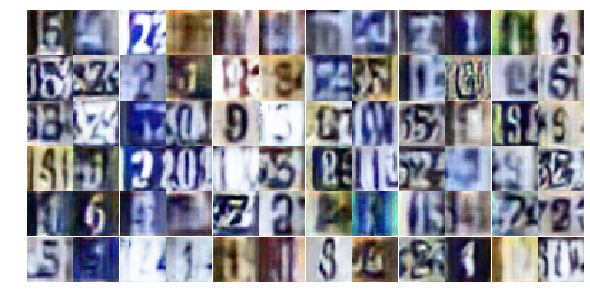

Epoch 21/100... Dloss: -3769.1067 Gloss: 6757.4092
Epoch 21/100... Dloss: -8312.3203 Gloss: 11779.8018
Epoch 21/100... Dloss: -2845.4600 Gloss: 6560.4272
Epoch 21/100... Dloss: -1525.5957 Gloss: 2897.0073
Epoch 21/100... Dloss: -3433.5293 Gloss: 6772.8281
Epoch 21/100... Dloss: -1198.7996 Gloss: 2244.2485
Epoch 21/100... Dloss: 1037.1078 Gloss: 3607.8137
Epoch 21/100... Dloss: -2421.6411 Gloss: 4041.8691
Epoch 21/100... Dloss: -3612.2192 Gloss: 5855.4165
Epoch 21/100... Dloss: 1273.5398 Gloss: 1371.5586


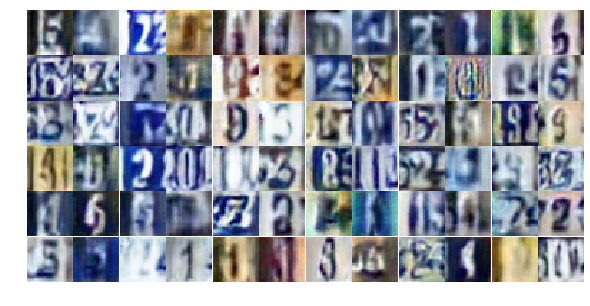

Epoch 21/100... Dloss: -3875.6538 Gloss: 6163.3193
(128, 100) (41, 32, 32, 3)
Epoch 22/100... Dloss: 378.3171 Gloss: 1412.9666
Epoch 22/100... Dloss: -2475.3005 Gloss: 3981.9712
Epoch 22/100... Dloss: -6839.6138 Gloss: 9302.8164
Epoch 22/100... Dloss: -1656.1111 Gloss: 3988.5061
Epoch 22/100... Dloss: -5361.1211 Gloss: 9379.1348
Epoch 22/100... Dloss: -2090.7478 Gloss: 4265.9282
Epoch 22/100... Dloss: -403.4160 Gloss: 3063.5425
Epoch 22/100... Dloss: -3560.1953 Gloss: 6403.9941
Epoch 22/100... Dloss: -2543.5200 Gloss: 4574.4248


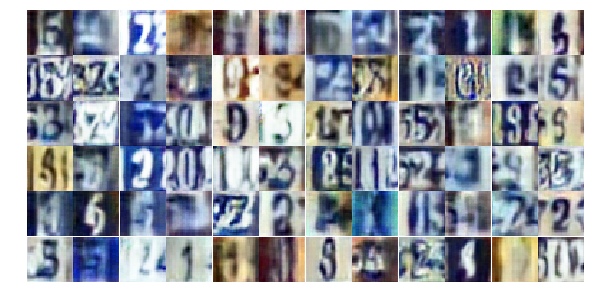

Epoch 22/100... Dloss: -2277.9189 Gloss: 4957.5654
Epoch 22/100... Dloss: -555.0447 Gloss: 771.7703
Epoch 22/100... Dloss: 27.4795 Gloss: 740.4193
Epoch 22/100... Dloss: -14423.7588 Gloss: 16672.3730
Epoch 22/100... Dloss: -2571.5376 Gloss: 6953.8848
Epoch 22/100... Dloss: -2596.6045 Gloss: 4164.3721
Epoch 22/100... Dloss: -6553.5293 Gloss: 8883.9883
Epoch 22/100... Dloss: -2804.9358 Gloss: 5493.6035
Epoch 22/100... Dloss: -4554.9009 Gloss: 7396.8354
Epoch 22/100... Dloss: -4558.3096 Gloss: 6908.8608


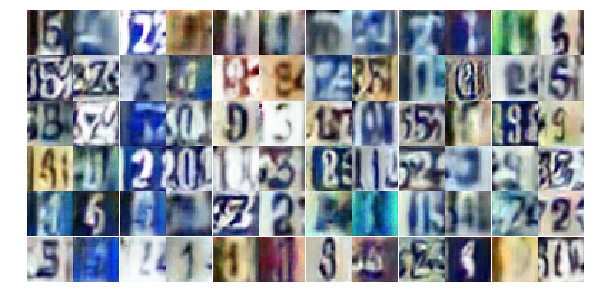

Epoch 22/100... Dloss: -361.3281 Gloss: 5299.5625
Epoch 22/100... Dloss: -3556.4351 Gloss: 5704.7559
Epoch 22/100... Dloss: -1469.3645 Gloss: 4326.7725
Epoch 22/100... Dloss: -3138.6379 Gloss: 5040.8330
Epoch 22/100... Dloss: -4572.7881 Gloss: 6229.6470
Epoch 22/100... Dloss: -1299.4084 Gloss: 3781.4373
Epoch 22/100... Dloss: -218.8853 Gloss: 5543.5762
Epoch 22/100... Dloss: -5233.6055 Gloss: 9578.4502
Epoch 22/100... Dloss: -1367.4423 Gloss: 8932.6582
Epoch 22/100... Dloss: -3381.3052 Gloss: 5703.9409


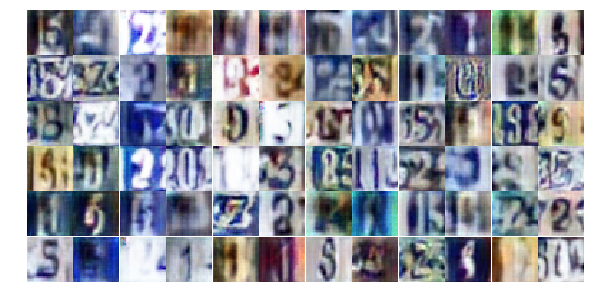

Epoch 22/100... Dloss: -716.0001 Gloss: 1783.0220
Epoch 22/100... Dloss: -4779.9297 Gloss: 7839.8350
Epoch 22/100... Dloss: -2820.0115 Gloss: 6529.6924
Epoch 22/100... Dloss: -2512.8186 Gloss: 4693.4150
Epoch 22/100... Dloss: -1330.6548 Gloss: 3617.8357
Epoch 22/100... Dloss: -4862.8379 Gloss: 7967.5903
Epoch 22/100... Dloss: 1746.7014 Gloss: 1118.7305
Epoch 22/100... Dloss: 1455.1345 Gloss: 757.4629
Epoch 22/100... Dloss: 769.0237 Gloss: 2985.2148
Epoch 22/100... Dloss: -4947.9155 Gloss: 7564.0527


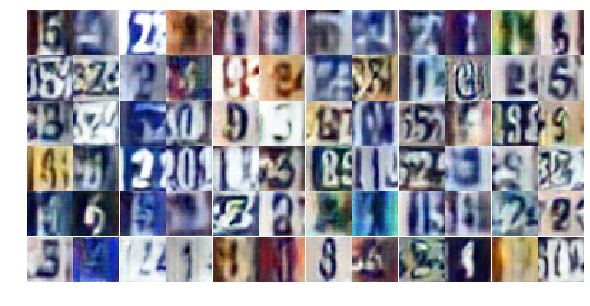

Epoch 22/100... Dloss: -4066.0325 Gloss: 7323.1348
Epoch 22/100... Dloss: -2907.0637 Gloss: 5628.7373
Epoch 22/100... Dloss: -2982.8196 Gloss: 6968.9277
Epoch 22/100... Dloss: -4168.4131 Gloss: 10112.4648
Epoch 22/100... Dloss: -2638.2241 Gloss: 7444.4229
Epoch 22/100... Dloss: -4222.3545 Gloss: 8029.7080
Epoch 22/100... Dloss: 1374.2654 Gloss: 1766.2762
Epoch 22/100... Dloss: -2633.7051 Gloss: 7109.3198
Epoch 22/100... Dloss: -4417.8257 Gloss: 6993.5781
Epoch 22/100... Dloss: -3332.3931 Gloss: 6154.5918


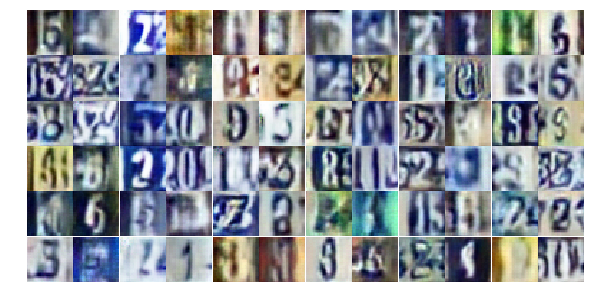

Epoch 22/100... Dloss: -1275.6067 Gloss: 3219.2224
Epoch 22/100... Dloss: -3267.2529 Gloss: 7362.9722
Epoch 22/100... Dloss: -2779.6833 Gloss: 5520.5264
Epoch 22/100... Dloss: -14235.5234 Gloss: 13576.2988
Epoch 22/100... Dloss: -4011.2820 Gloss: 5454.6919
Epoch 22/100... Dloss: -5275.1689 Gloss: 9049.0234
Epoch 22/100... Dloss: -755.3003 Gloss: 4131.3213
Epoch 22/100... Dloss: -6195.8154 Gloss: 10957.6934
(128, 100) (41, 32, 32, 3)
Epoch 23/100... Dloss: -1369.4048 Gloss: 2681.8167
Epoch 23/100... Dloss: -799.7775 Gloss: 3988.2900


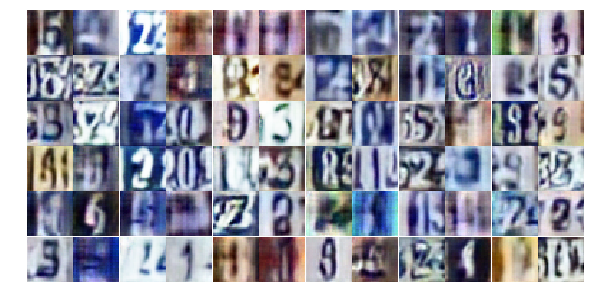

Epoch 23/100... Dloss: -5086.7734 Gloss: 8049.7529
Epoch 23/100... Dloss: 528.1868 Gloss: 2657.8379
Epoch 23/100... Dloss: -488.4839 Gloss: 1303.5012
Epoch 23/100... Dloss: -233.6897 Gloss: 668.1014
Epoch 23/100... Dloss: -634.0504 Gloss: 992.3479
Epoch 23/100... Dloss: -2673.7773 Gloss: 4412.8096
Epoch 23/100... Dloss: -1580.7764 Gloss: 3539.6272
Epoch 23/100... Dloss: -666.0269 Gloss: 2644.7900
Epoch 23/100... Dloss: -6347.9517 Gloss: 8788.4668
Epoch 23/100... Dloss: -5171.2158 Gloss: 9417.0723


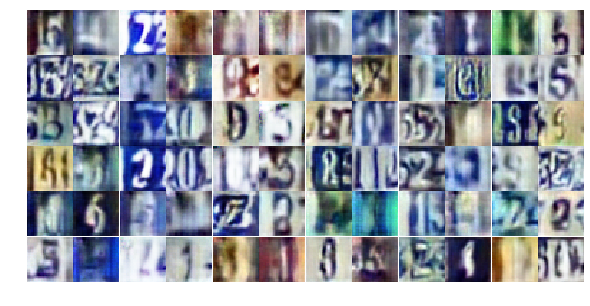

Epoch 23/100... Dloss: 168.6265 Gloss: 1791.7056
Epoch 23/100... Dloss: -1526.0128 Gloss: 4414.9556
Epoch 23/100... Dloss: -2329.5742 Gloss: 4393.7769
Epoch 23/100... Dloss: -7683.0537 Gloss: 10733.2305
Epoch 23/100... Dloss: -1121.0298 Gloss: 10168.8623
Epoch 23/100... Dloss: -4451.5947 Gloss: 10377.6719
Epoch 23/100... Dloss: -2989.3250 Gloss: 6088.5156
Epoch 23/100... Dloss: -5164.9258 Gloss: 8478.1270
Epoch 23/100... Dloss: -3405.6895 Gloss: 7033.0527
Epoch 23/100... Dloss: -2811.3120 Gloss: 5208.8828


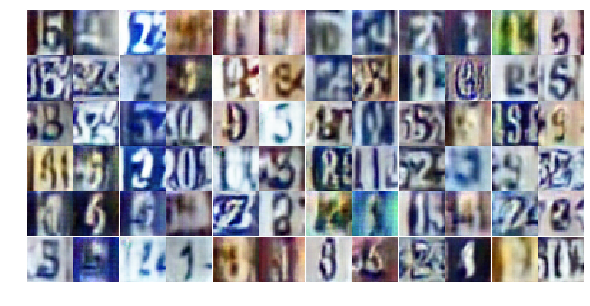

Epoch 23/100... Dloss: -1616.8748 Gloss: 6006.1924
Epoch 23/100... Dloss: -6410.5527 Gloss: 9001.5996
Epoch 23/100... Dloss: -4419.9316 Gloss: 7006.2500
Epoch 23/100... Dloss: -4246.5439 Gloss: 6265.0737
Epoch 23/100... Dloss: -5887.3369 Gloss: 9708.8955
Epoch 23/100... Dloss: -3249.2234 Gloss: 6896.6304
Epoch 23/100... Dloss: -51.1260 Gloss: 2345.5146
Epoch 23/100... Dloss: -2308.7783 Gloss: 5070.9111
Epoch 23/100... Dloss: -8447.8379 Gloss: 10824.1836
Epoch 23/100... Dloss: 688.9084 Gloss: 11877.8135


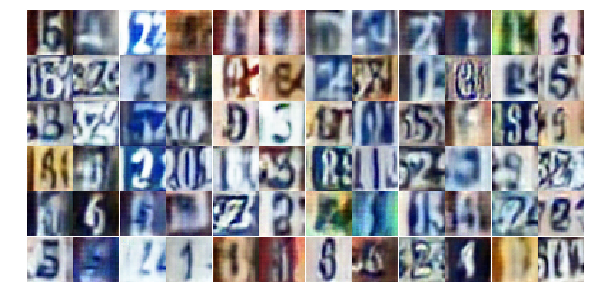

Epoch 23/100... Dloss: -1129.7273 Gloss: 2066.0203
Epoch 23/100... Dloss: -357.3529 Gloss: 861.8481
Epoch 23/100... Dloss: 254.0527 Gloss: 945.3779
Epoch 23/100... Dloss: -8734.7441 Gloss: 10747.4316
Epoch 23/100... Dloss: -3714.1208 Gloss: 6387.9580
Epoch 23/100... Dloss: -2616.2112 Gloss: 8671.6992
Epoch 23/100... Dloss: -1674.9031 Gloss: 4167.5752
Epoch 23/100... Dloss: -6183.5073 Gloss: 8873.9854
Epoch 23/100... Dloss: 79.5190 Gloss: 949.6736
Epoch 23/100... Dloss: -8222.9619 Gloss: 13446.0996


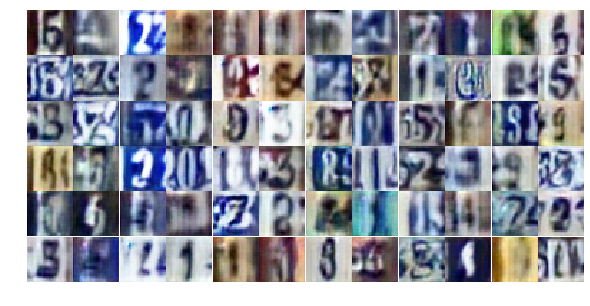

Epoch 23/100... Dloss: -4713.3555 Gloss: 6855.2793
Epoch 23/100... Dloss: -1991.9409 Gloss: 5448.8496
Epoch 23/100... Dloss: -8221.4971 Gloss: 12021.1758
Epoch 23/100... Dloss: -2042.4941 Gloss: 4098.8003
Epoch 23/100... Dloss: -931.2168 Gloss: 2161.9343
Epoch 23/100... Dloss: -7962.2852 Gloss: 11123.4766
Epoch 23/100... Dloss: -7057.5645 Gloss: 11350.6123
Epoch 23/100... Dloss: -5738.0723 Gloss: 9092.5078
Epoch 23/100... Dloss: -5884.0322 Gloss: 9087.9824
Epoch 23/100... Dloss: -870.2815 Gloss: 1538.8076


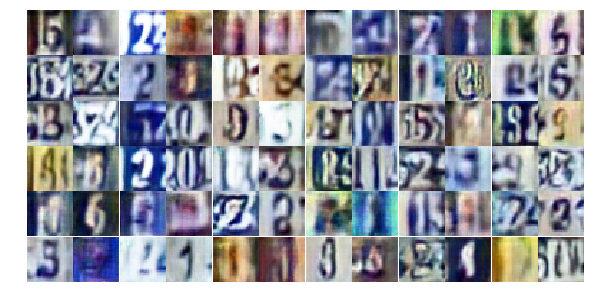

Epoch 23/100... Dloss: -804.0338 Gloss: 3753.4771
Epoch 23/100... Dloss: -397.0244 Gloss: 3390.5386
Epoch 23/100... Dloss: -3709.8276 Gloss: 4357.5537
Epoch 23/100... Dloss: -3513.9961 Gloss: 6924.3110
Epoch 23/100... Dloss: -4104.5723 Gloss: 6840.7646
(128, 100) (41, 32, 32, 3)
Epoch 24/100... Dloss: 81.4754 Gloss: 183.6734
Epoch 24/100... Dloss: 256.5304 Gloss: -51.8116
Epoch 24/100... Dloss: -175.4732 Gloss: 326.3464
Epoch 24/100... Dloss: -1721.7621 Gloss: 2523.9768
Epoch 24/100... Dloss: -3361.3379 Gloss: 8866.1250


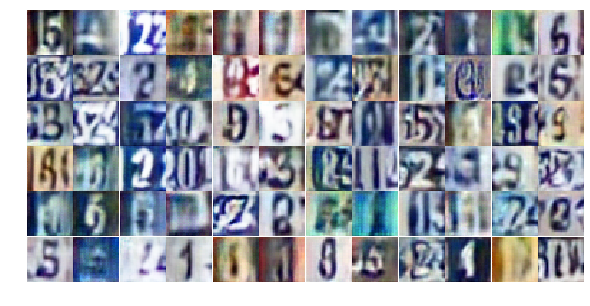

Epoch 24/100... Dloss: -4042.0039 Gloss: 5904.7446
Epoch 24/100... Dloss: 22.3705 Gloss: 1480.7991
Epoch 24/100... Dloss: -2874.0833 Gloss: 5312.3481
Epoch 24/100... Dloss: -5403.7144 Gloss: 7869.3330
Epoch 24/100... Dloss: -4773.7764 Gloss: 7525.2383
Epoch 24/100... Dloss: -3189.3706 Gloss: 5760.3145
Epoch 24/100... Dloss: -3696.5862 Gloss: 10249.3408
Epoch 24/100... Dloss: -3473.1472 Gloss: 8561.6934
Epoch 24/100... Dloss: -1417.6497 Gloss: 4730.7964
Epoch 24/100... Dloss: -4981.5000 Gloss: 9471.4805


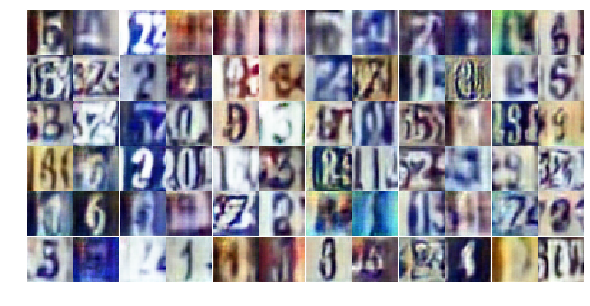

Epoch 24/100... Dloss: -414.0161 Gloss: 2496.9058
Epoch 24/100... Dloss: -2772.4243 Gloss: 6143.3101
Epoch 24/100... Dloss: -2777.9072 Gloss: 4737.8242
Epoch 24/100... Dloss: -5850.0947 Gloss: 8641.1738
Epoch 24/100... Dloss: -5262.2168 Gloss: 8407.5703
Epoch 24/100... Dloss: -2580.4031 Gloss: 4856.9033
Epoch 24/100... Dloss: -1956.9911 Gloss: 6620.1699
Epoch 24/100... Dloss: -4370.1196 Gloss: 9454.8818
Epoch 24/100... Dloss: -4218.6953 Gloss: 6807.7124
Epoch 24/100... Dloss: -6602.1982 Gloss: 10595.8330


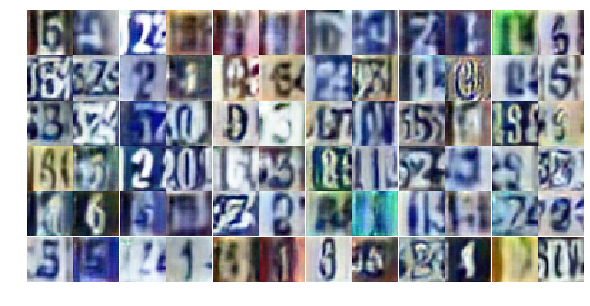

Epoch 24/100... Dloss: -5157.3223 Gloss: 7893.5693
Epoch 24/100... Dloss: -730.7792 Gloss: 991.9739
Epoch 24/100... Dloss: -1715.2351 Gloss: 3741.1372
Epoch 24/100... Dloss: -3988.0200 Gloss: 6461.5000
Epoch 24/100... Dloss: 585.0264 Gloss: 2331.5112
Epoch 24/100... Dloss: -8825.4453 Gloss: 11594.8066
Epoch 24/100... Dloss: 586.2199 Gloss: 2636.5181
Epoch 24/100... Dloss: -1561.8250 Gloss: 3106.5874
Epoch 24/100... Dloss: -970.2053 Gloss: 4222.6396
Epoch 24/100... Dloss: -422.8449 Gloss: 4068.3755


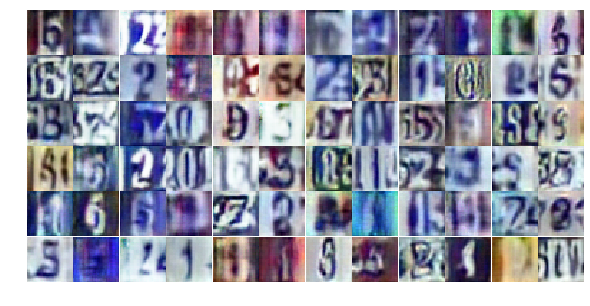

Epoch 24/100... Dloss: -729.7070 Gloss: 3627.4060
Epoch 24/100... Dloss: -7932.2568 Gloss: 11836.8086
Epoch 24/100... Dloss: -1567.9368 Gloss: 3406.2031
Epoch 24/100... Dloss: -2026.3480 Gloss: 3366.9055
Epoch 24/100... Dloss: -7178.7969 Gloss: 10109.5547
Epoch 24/100... Dloss: -5097.6426 Gloss: 7581.1250
Epoch 24/100... Dloss: -4976.8594 Gloss: 8521.8047
Epoch 24/100... Dloss: -2763.2939 Gloss: 6774.1338
Epoch 24/100... Dloss: -258.9285 Gloss: 798.9448
Epoch 24/100... Dloss: -405.6895 Gloss: 868.0814


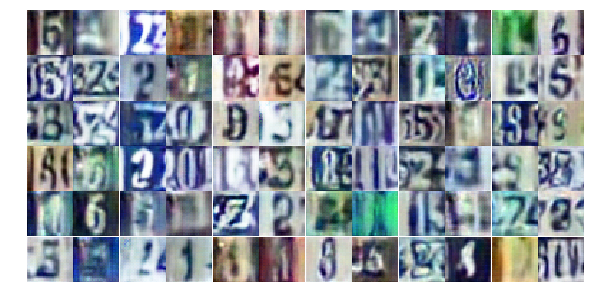

Epoch 24/100... Dloss: -358.4734 Gloss: 584.2960
Epoch 24/100... Dloss: 416.4423 Gloss: 49.4433
Epoch 24/100... Dloss: -411.8392 Gloss: 673.1933
Epoch 24/100... Dloss: -400.9323 Gloss: 869.0393
Epoch 24/100... Dloss: -737.5040 Gloss: 1130.4287
Epoch 24/100... Dloss: -454.4504 Gloss: 1207.8699
Epoch 24/100... Dloss: -415.8611 Gloss: 1641.8481
Epoch 24/100... Dloss: -766.2042 Gloss: 2251.3982
Epoch 24/100... Dloss: -714.2846 Gloss: 2048.1265
Epoch 24/100... Dloss: -206.0931 Gloss: 908.1138


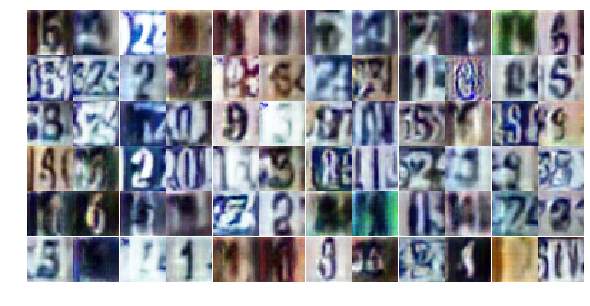

Epoch 24/100... Dloss: 283.4840 Gloss: 610.0618
Epoch 24/100... Dloss: 46.9077 Gloss: 486.7291
(128, 100) (41, 32, 32, 3)
Epoch 25/100... Dloss: -7139.0405 Gloss: 9341.9141
Epoch 25/100... Dloss: -148.4914 Gloss: 549.1444
Epoch 25/100... Dloss: -1580.9514 Gloss: 2900.8848
Epoch 25/100... Dloss: -3196.4519 Gloss: 6258.8330
Epoch 25/100... Dloss: -5654.5439 Gloss: 8004.2637
Epoch 25/100... Dloss: -2414.9355 Gloss: 6606.4375
Epoch 25/100... Dloss: -4510.1763 Gloss: 6428.3848
Epoch 25/100... Dloss: -5815.0381 Gloss: 12709.7520


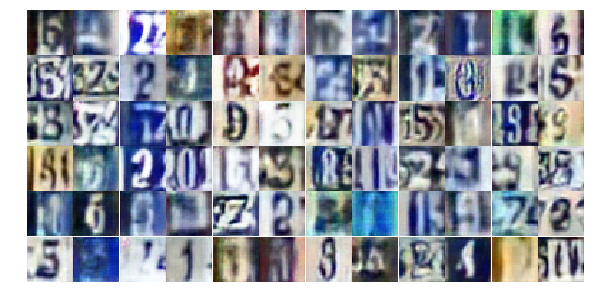

Epoch 25/100... Dloss: -122.6615 Gloss: 340.7330
Epoch 25/100... Dloss: -1513.4963 Gloss: 1835.6450
Epoch 25/100... Dloss: -237.5384 Gloss: 595.4214
Epoch 25/100... Dloss: -55.6883 Gloss: 525.0888
Epoch 25/100... Dloss: 28.5222 Gloss: 464.4163
Epoch 25/100... Dloss: -866.9978 Gloss: 1073.1879
Epoch 25/100... Dloss: 773.3442 Gloss: -452.7505
Epoch 25/100... Dloss: -530.3414 Gloss: 918.8174
Epoch 25/100... Dloss: -2223.9536 Gloss: 4272.3018
Epoch 25/100... Dloss: -4021.3940 Gloss: 6442.8447


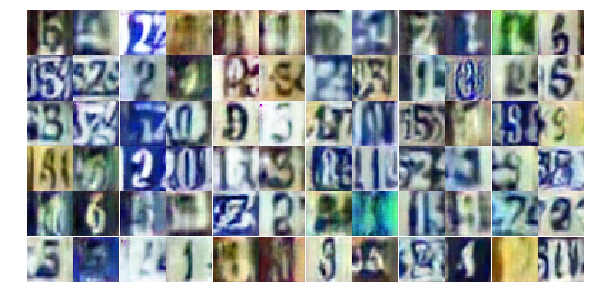

Epoch 25/100... Dloss: -4742.7036 Gloss: 7145.1387
Epoch 25/100... Dloss: -4651.2090 Gloss: 8376.7344
Epoch 25/100... Dloss: -2345.9763 Gloss: 4505.8169
Epoch 25/100... Dloss: -1539.4626 Gloss: 3907.4690
Epoch 25/100... Dloss: -5031.6758 Gloss: 7957.1641
Epoch 25/100... Dloss: -3617.9038 Gloss: 5651.1655
Epoch 25/100... Dloss: 10188.6787 Gloss: -4569.5503
Epoch 25/100... Dloss: -1274.4858 Gloss: 2603.5356
Epoch 25/100... Dloss: -3160.3882 Gloss: 6483.1968
Epoch 25/100... Dloss: -1039.0610 Gloss: 3674.2827


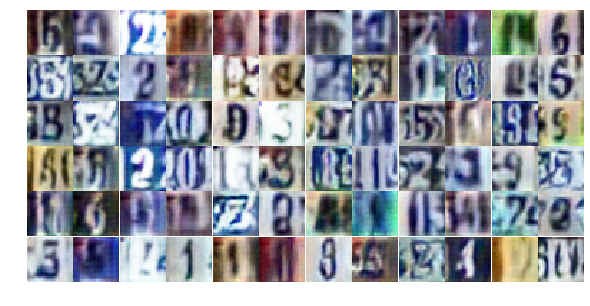

Epoch 25/100... Dloss: 3987.6528 Gloss: -426.5577
Epoch 25/100... Dloss: -133.4267 Gloss: 564.3011
Epoch 25/100... Dloss: 2351.4983 Gloss: -821.1757
Epoch 25/100... Dloss: 982.3494 Gloss: 676.8798
Epoch 25/100... Dloss: -1794.9292 Gloss: 6814.4678
Epoch 25/100... Dloss: -2588.8264 Gloss: 6272.3901
Epoch 25/100... Dloss: -4788.5396 Gloss: 8728.8262
Epoch 25/100... Dloss: 589.5496 Gloss: -213.0748
Epoch 25/100... Dloss: 215.4791 Gloss: -57.9846
Epoch 25/100... Dloss: 30.1465 Gloss: 71.6595


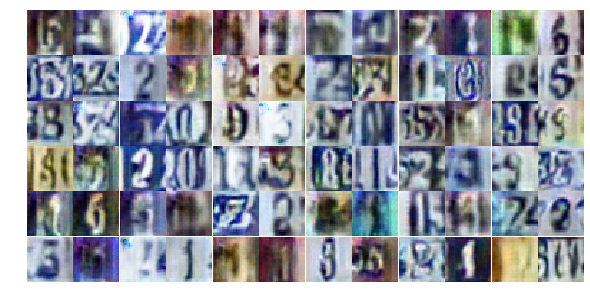

Epoch 25/100... Dloss: -1041.4412 Gloss: 1773.6586
Epoch 25/100... Dloss: -4225.9941 Gloss: 7399.4102
Epoch 25/100... Dloss: -2330.9265 Gloss: 3884.1802
Epoch 25/100... Dloss: -2770.9819 Gloss: 6504.5825
Epoch 25/100... Dloss: -4667.4771 Gloss: 7462.2866
Epoch 25/100... Dloss: 255.8916 Gloss: 2486.6455
Epoch 25/100... Dloss: 306.1860 Gloss: 1906.2531
Epoch 25/100... Dloss: -3797.8538 Gloss: 8050.8545
Epoch 25/100... Dloss: -1427.1935 Gloss: 6039.6514
Epoch 25/100... Dloss: -3059.2166 Gloss: 6078.7432


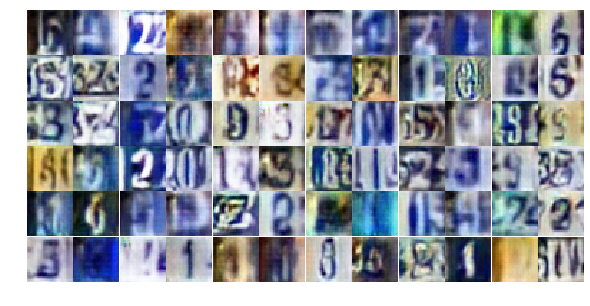

Epoch 25/100... Dloss: -6534.0737 Gloss: 9829.8291
Epoch 25/100... Dloss: -39.9889 Gloss: 1671.1667
Epoch 25/100... Dloss: 1158.8500 Gloss: 1813.0969
Epoch 25/100... Dloss: -1011.5280 Gloss: 3975.0327
Epoch 25/100... Dloss: -4079.5811 Gloss: 6253.0410
Epoch 25/100... Dloss: -6072.2646 Gloss: 9677.7109


In [ ]:
losses, samples = train(net=net, dataset=dataset, epochs=epochs, batch_size=batch_size, figsize=(10,5))

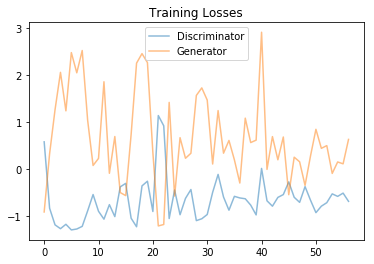

In [22]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

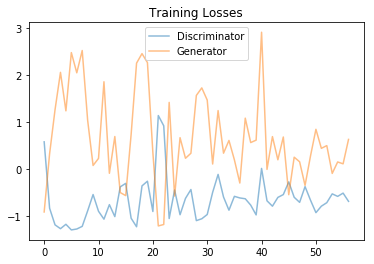

In [23]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

/home/arasdar/anaconda3/envs/env/lib/python3.6/site-packages/matplotlib/axes/_base.py:1400: MatplotlibDeprecationWarning: The 'box-forced' keyword argument is deprecated since 2.2.
  " since 2.2.", cbook.mplDeprecation)


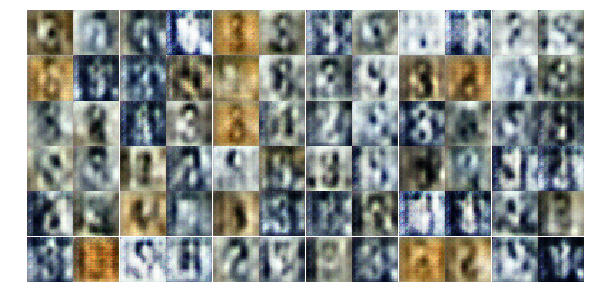

In [24]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))

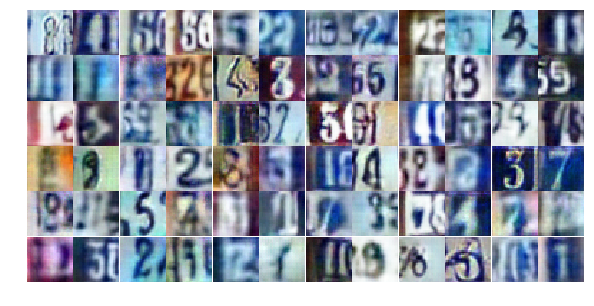

In [19]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))